### Initial Data Check

In [87]:
import os
import cv2
import matplotlib.pyplot as plt
from shutil import copy
import random
import math
import numpy as np
from IPython.display import Image, display
from tensorflow.keras.preprocessing.image import load_img
import PIL
from PIL import ImageOps

In [20]:
data_path = r'C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal'

In [3]:
# Number of files in training and testing folders

n_input_train = len([f for f in os.listdir(os.path.join(data_path,'training','input')) if f.endswith('png')])
print(f'Input TRAIN has {n_input_train} images')
n_output_train = len([f for f in os.listdir(os.path.join(data_path,'training','output')) if f.endswith('png')])
print(f'Output TRAIN has {n_output_train} images')
n_input_test = len([f for f in os.listdir(os.path.join(data_path,'testing','input')) if f.endswith('png')])
print(f'Input TEST has {n_input_test} images')
n_output_test = len([f for f in os.listdir(os.path.join(data_path,'testing','output')) if f.endswith('png')])
print(f'Output TEST has {n_output_test} images')

Input TRAIN has 1105 images
Output TRAIN has 804 images
Input TEST has 13 images
Output TEST has 13 images


Train input has 1105 images but train output as only 804. So, we need to map inpput and output images before any any further steps

In [4]:
def map_train_images(input_folder, output_folder, new_input, new_output):
    for img_file in os.listdir(input_folder):
        if img_file in os.listdir(output_folder):
            if not os.path.exists(new_input):
                os.makedirs(new_input)
            if not os.path.exists(new_output):
                os.makedirs(new_output)
                
            src_input = os.path.join(input_folder, img_file)
            dst_input = os.path.join(new_input, img_file)
            src_output = os.path.join(output_folder, img_file)
            dst_output = os.path.join(new_output, img_file)
            
            copy(src_input, dst_input)
            copy(src_output, dst_output)

In [9]:
input_folder = os.path.join(data_path, 'training', 'input')
output_folder = os.path.join(data_path, 'training', 'output')
new_input = os.path.join(data_path, 'training', 'new_input')
new_output = os.path.join(data_path, 'training', 'new_output')

In [6]:
%%time

map_train_images(input_folder, output_folder, new_input, new_output)

Wall time: 48.1 s


In [6]:
# Number of files in training new input and new output folders

n_input_train = len([f for f in os.listdir(os.path.join(data_path,'training','new_input')) if f.endswith('png')])
print(f'NEW Input TRAIN has {n_input_train} images')
n_output_train = len([f for f in os.listdir(os.path.join(data_path,'training','new_output')) if f.endswith('png')])
print(f'NEW Output TRAIN has {n_output_train} images')

NEW Input TRAIN has 804 images
NEW Output TRAIN has 804 images


Now input and output folders have the same number of images. 

Also, it is noticed during manual check that some input images has blank/white patches but their corresponding output mask has well defined roads in those blank areas. This can be potential data issue and need to be addressed.

#### Below are partially blank input images and their corresponding masks
Clearly we cannot use them because the model will learn 'incorrect' roads on the blank areas

In [7]:
def show_image_and_mask(image, mask):
    plt.figure(figsize=(10,10))
    plt.subplot(121)
    plt.imshow(image)
    plt.axis('off')
    plt.title('IMAGE')
    plt.subplot(122)
    plt.imshow(mask)
    plt.axis('off')
    plt.title('MASK')
    plt.show()

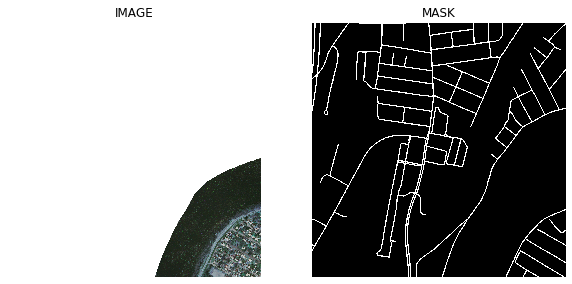

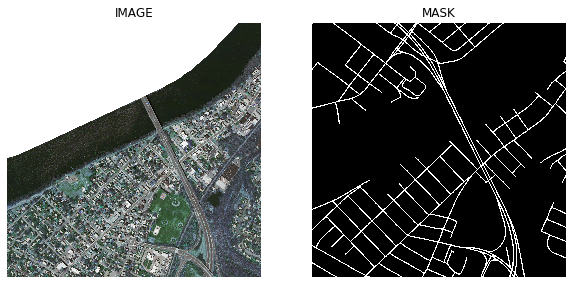

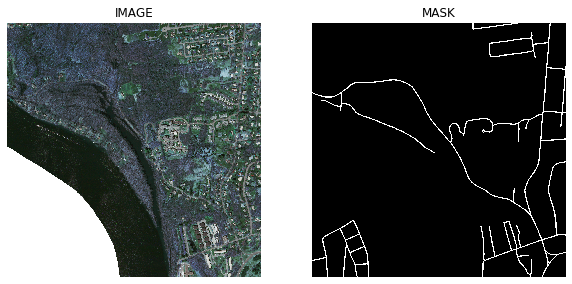

In [10]:
f_imgs = ['img-46.png','img-60.png','img-62.png']
for i in f_imgs:
    in_img = cv2.imread(os.path.join(input_folder, i))
    out_img = cv2.imread(os.path.join(output_folder, i))
    show_image_and_mask(in_img, out_img)

#### Below are the indices of input images to be not matching with the output mask found manually

In [11]:
faulty_images_indices = [7,13,14,16,24,44,45,46,49,60,62,64,76,80,81,83,118,119,120,121,184,200,204,205,246,
                         250,272,358,384,389,430,434,507,514,531,532,564,604,606,607,611,630,686,817,845,868,
                         890,909,910,911,981,1051,1081]
faulty_images = ['img-'+str(f)+'.png' for f in faulty_images_indices]
print(f'{len(faulty_images)} images are found not usable')

53 images are found not usable


#### Removing all inconsistent images

In [12]:
%%time
for f in faulty_images:
    input_file = os.path.join(new_input, f)
    output_file = os.path.join(new_output, f)
    if os.path.exists(input_file):
        os.remove(input_file)
    if os.path.exists(output_file):
        os.remove(output_file)

Wall time: 1e+03 ms


In [13]:
# Number of files in training new input and new output folders

n_input_train = len([f for f in os.listdir(os.path.join(data_path,'training','new_input')) if f.endswith('png')])
print(f'NEW Input TRAIN has {n_input_train} images')
n_output_train = len([f for f in os.listdir(os.path.join(data_path,'training','new_output')) if f.endswith('png')])
print(f'NEW Output TRAIN has {n_output_train} images')

NEW Input TRAIN has 751 images
NEW Output TRAIN has 751 images


In [19]:
random_image_file = random.choice(os.listdir(new_input))
random_image = cv2.imread(os.path.join(new_input, random_image_file))
print(random_image_file, random_image.shape)

img-166.png (1500, 1500, 3)


Size of the input images (1500, 1500) is very large and thus it may take long time to train any CNN model. Better idea is to either resize or crop the image. Further, resizing may distort the spatial orientation of the map entities, thus cropping seems to be a good choice.

#### Black and white pixel analysis
Analysis on the training output images (masks) to determine how many images have very less white / black pixels

Results:

Valid=726,  Invalid=25,  Cutoff=0.01

Valid=636,  Invalid=127,  Cutoff=0.02

Valid=533,  Invalid=230,  Cutoff=0.03

We can go with a cutoff = 0.01 i.e. get rid of the images where mask has less than 1% white/black pixel ratio

In [21]:
%%time
valid, invalid = 0, 0
cutoff = 0.01
for m in os.listdir(new_output):
    mask = cv2.imread(os.path.join(new_output, m))
    black_pixel_count = np.sum(mask==0)
    white_pixel_count = np.sum(mask==255)
    wht_blk_ratio = white_pixel_count/black_pixel_count
    if wht_blk_ratio < cutoff:
        invalid += 1
    else:
        valid += 1
print(f'Valid={valid},  Invalid={invalid},  Cutoff={cutoff}')

Valid=726,  Invalid=25,  Cutoff=0.01
Wall time: 50.1 s


It is good to binarize the masks to have only black or white pixels rather than any value in range [0, 255] Before selectig a threshold value, I did trial and error and selected a value of 50.

In [23]:
def threshold_binarize_mask(mask, threshold=50):
    mask[mask>100]=255
    mask[mask<=100]=0
    return mask

#### Imgae Cropping POC

In [115]:
1500//256, 1500%256

(5, 220)

In [23]:
def estimate_crops(start, end, height, width):
    count, miss = 0, 0
    for h in range(start, end, height):
        for w in range(start, end, width):
            print(w, '------', end='')
            if h+height <= end and w+width <= end:
                count += 1
            else:
                miss += 1
        print('\n')
    print(f'\nCOUNT = {count},  MISS = {miss}')

In [24]:
estimate_crops(0, 1500, 250, 250)

0 ------250 ------500 ------750 ------1000 ------1250 ------

0 ------250 ------500 ------750 ------1000 ------1250 ------

0 ------250 ------500 ------750 ------1000 ------1250 ------

0 ------250 ------500 ------750 ------1000 ------1250 ------

0 ------250 ------500 ------750 ------1000 ------1250 ------

0 ------250 ------500 ------750 ------1000 ------1250 ------


COUNT = 36,  MISS = 0


Cropping (1500, 1500) image in (250, 250) chunks we will get 36 complete chunks. Looks good!

In [25]:
# estimate_crops(110, 1500, 256, 256)

Image: img-71_1.png


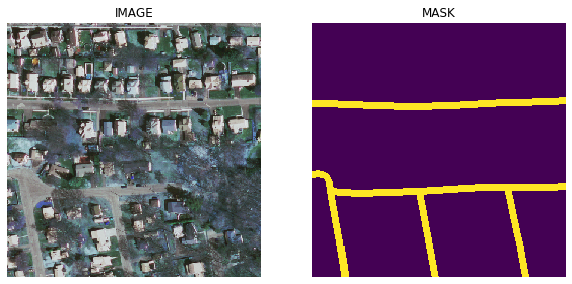

Image=250, 250 Mask=250, 250
1
Image: img-71_2.png


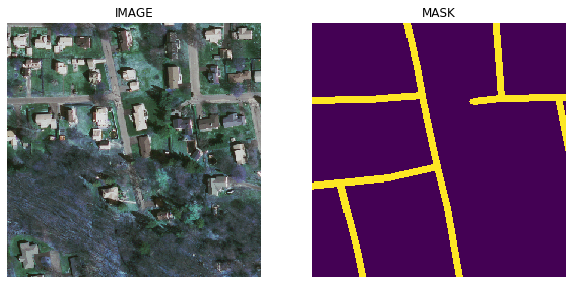

Image=250, 250 Mask=250, 250
2
Image: img-71_3.png


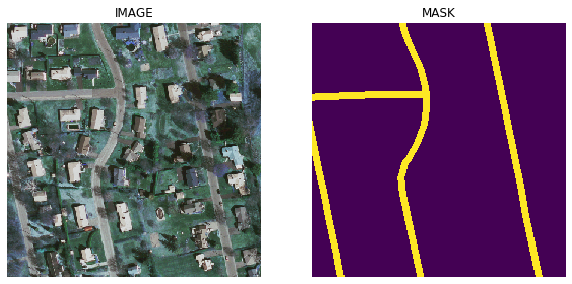

Image=250, 250 Mask=250, 250
3
Image: img-71_4.png


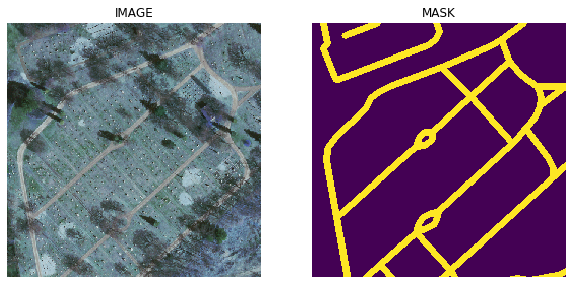

Image=250, 250 Mask=250, 250
4
Image: img-71_5.png


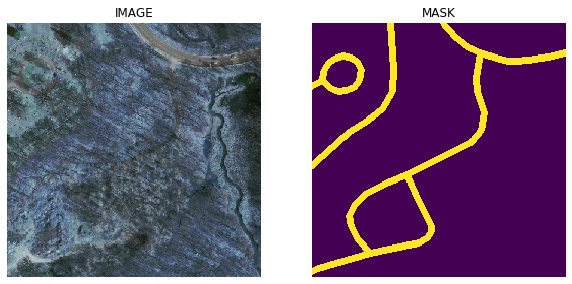

Image=250, 250 Mask=250, 250
5
Image: img-71_6.png


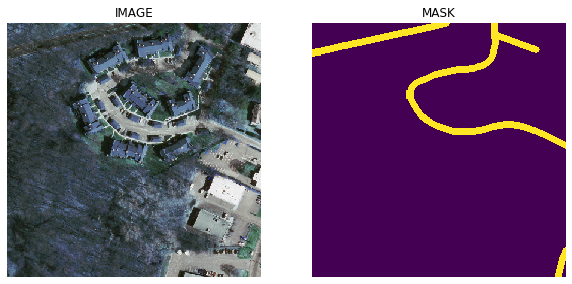

Image=250, 250 Mask=250, 250
6
Image: img-71_7.png


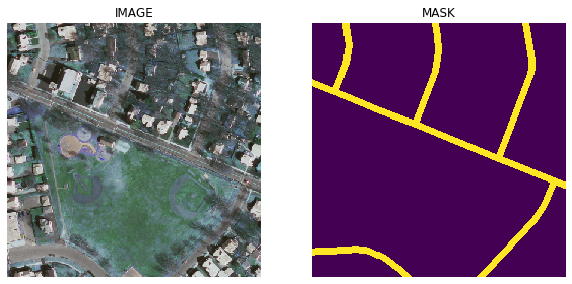

Image=250, 250 Mask=250, 250
7
Image: img-71_8.png


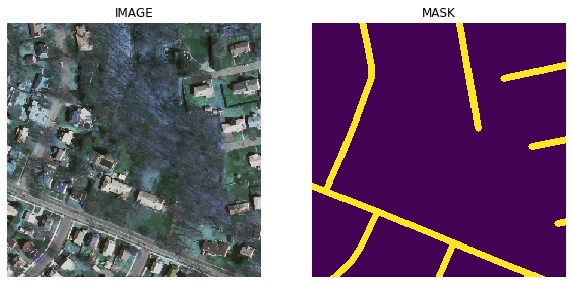

Image=250, 250 Mask=250, 250
8
Image: img-71_9.png


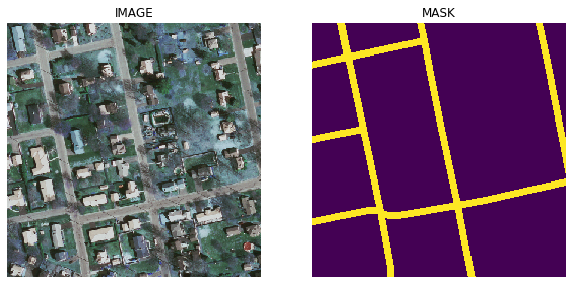

Image=250, 250 Mask=250, 250
9
Image: img-71_10.png


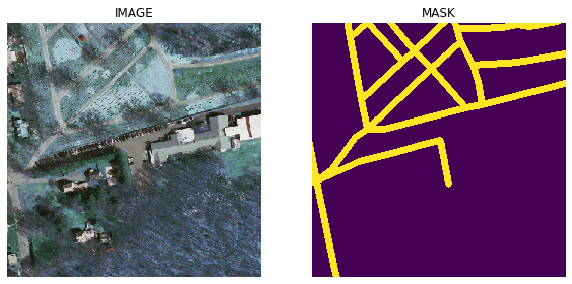

Image=250, 250 Mask=250, 250
10
Image: img-71_11.png
Image: img-71_11.png


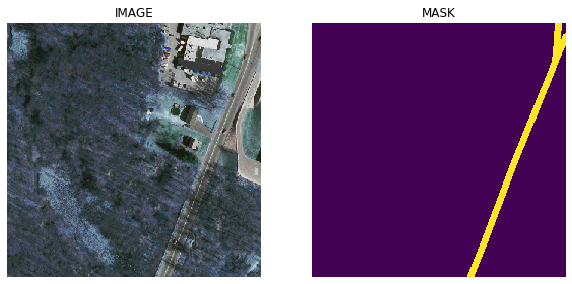

Image=250, 250 Mask=250, 250
11
Image: img-71_12.png


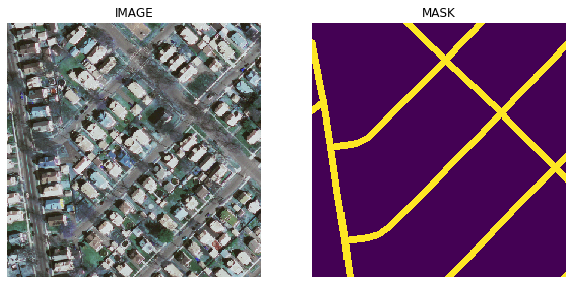

Image=250, 250 Mask=250, 250
12
Image: img-71_13.png


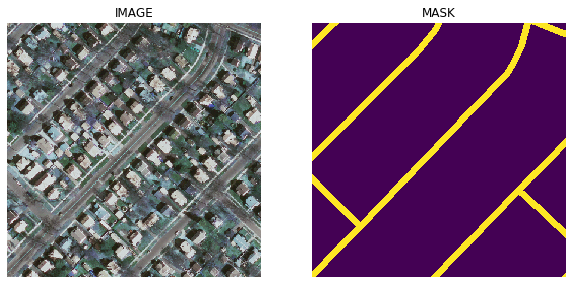

Image=250, 250 Mask=250, 250
13
Image: img-71_14.png


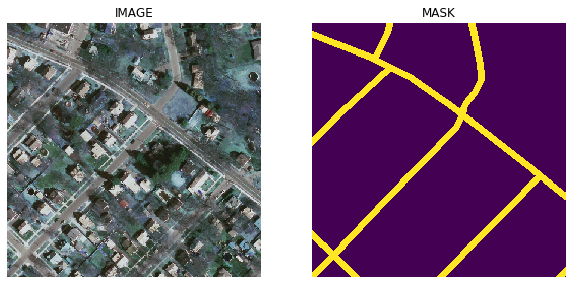

Image=250, 250 Mask=250, 250
14
Image: img-71_15.png


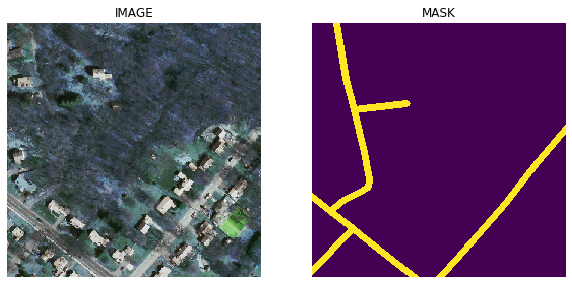

Image=250, 250 Mask=250, 250
15
Image: img-71_16.png
Image: img-71_16.png


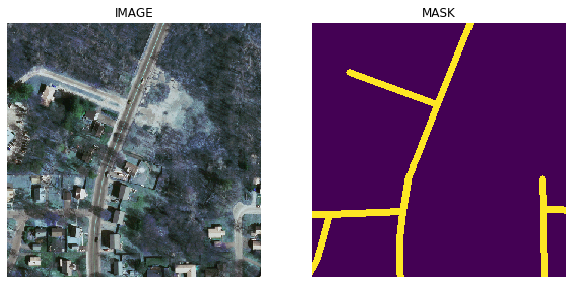

Image=250, 250 Mask=250, 250
16
Image: img-71_17.png


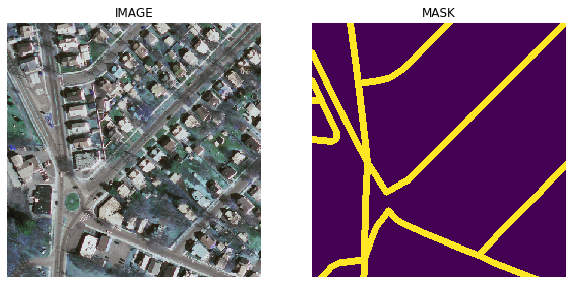

Image=250, 250 Mask=250, 250
17
Image: img-71_18.png


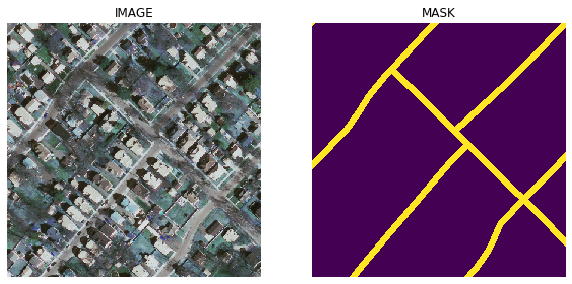

Image=250, 250 Mask=250, 250
18
Image: img-71_19.png


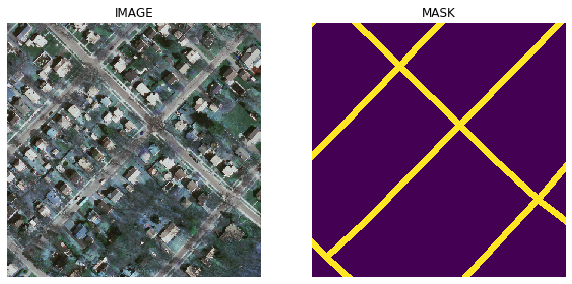

Image=250, 250 Mask=250, 250
19
Image: img-71_20.png


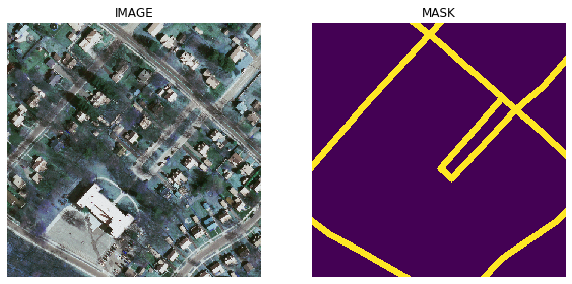

Image=250, 250 Mask=250, 250
20
Image: img-71_21.png


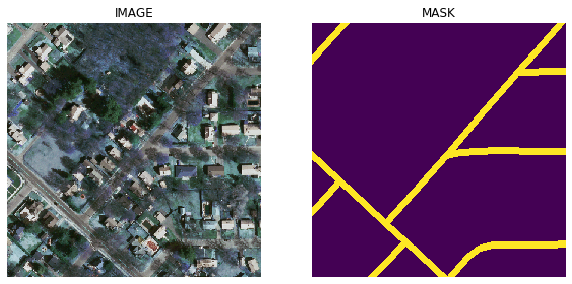

Image=250, 250 Mask=250, 250
21
Image: img-71_22.png


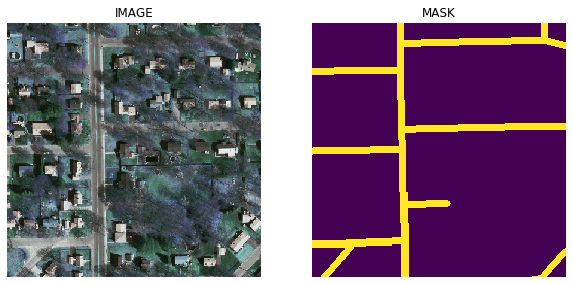

Image=250, 250 Mask=250, 250
22
Image: img-71_23.png


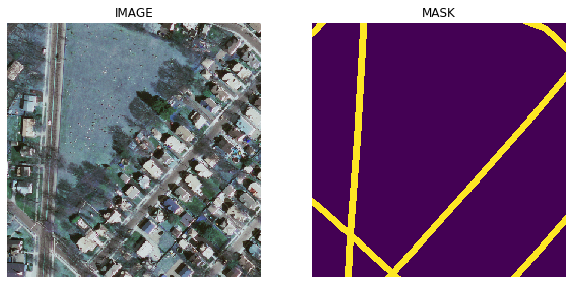

Image=250, 250 Mask=250, 250
23
Image: img-71_24.png


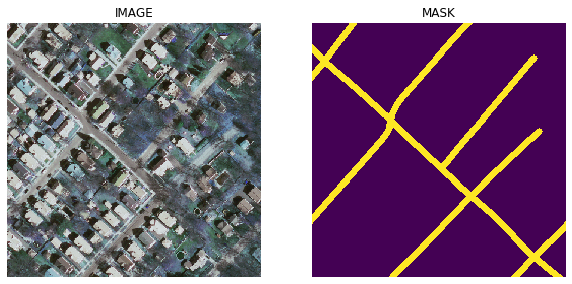

Image=250, 250 Mask=250, 250
24
Image: img-71_25.png


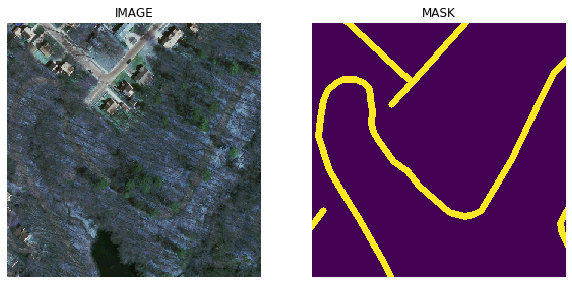

Image=250, 250 Mask=250, 250
25
Image: img-71_26.png


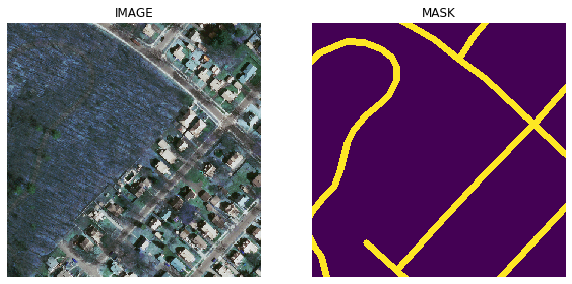

Image=250, 250 Mask=250, 250
26
Image: img-71_27.png


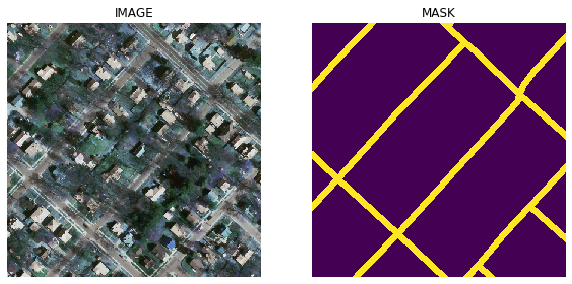

Image=250, 250 Mask=250, 250
27
Image: img-71_28.png


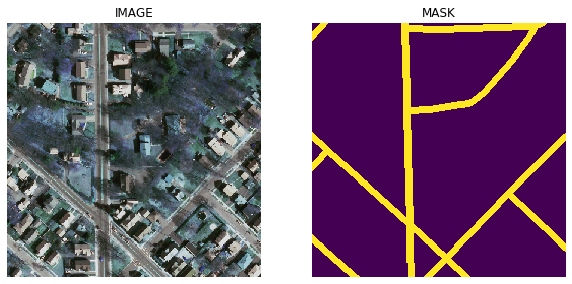

Image=250, 250 Mask=250, 250
28
Image: img-71_29.png


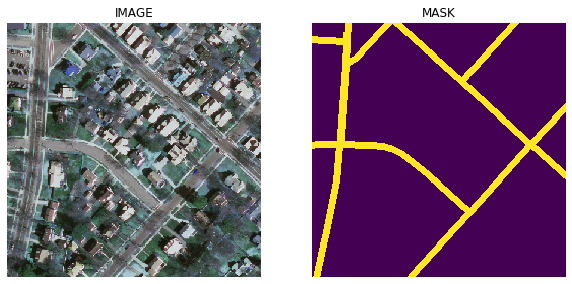

Image=250, 250 Mask=250, 250
29
Image: img-71_30.png


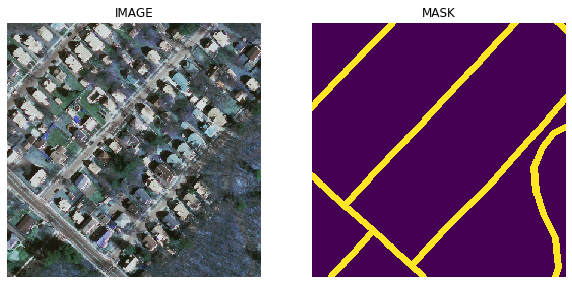

Image=250, 250 Mask=250, 250
30
Image: img-71_31.png


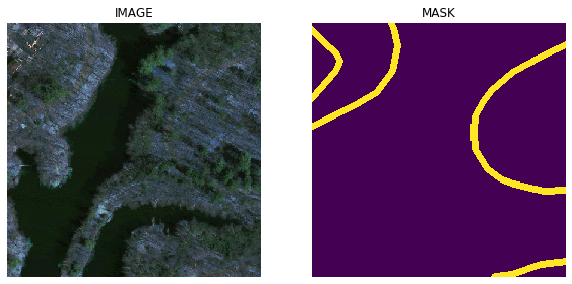

Image=250, 250 Mask=250, 250
31
Image: img-71_32.png


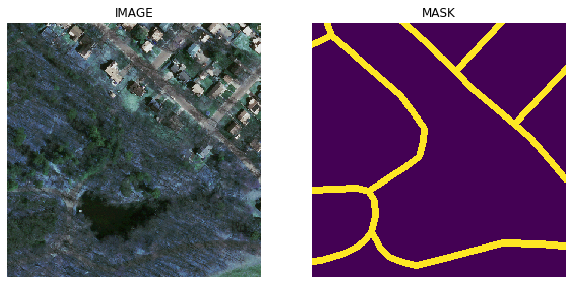

Image=250, 250 Mask=250, 250
32
Image: img-71_33.png


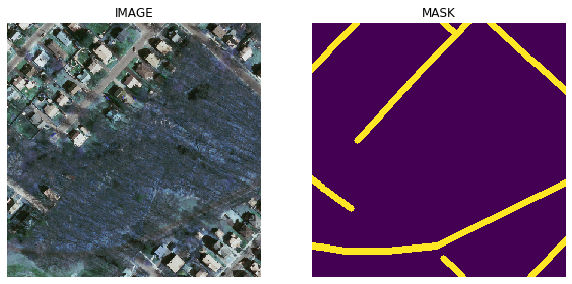

Image=250, 250 Mask=250, 250
33
Image: img-71_34.png


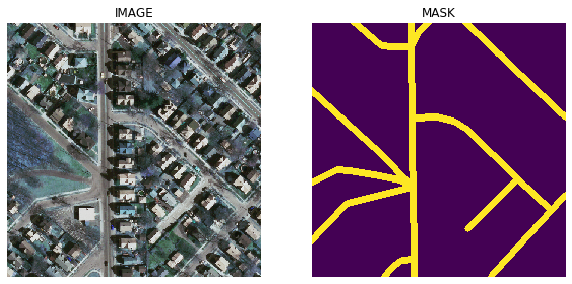

Image=250, 250 Mask=250, 250
34
Image: img-72_1.png


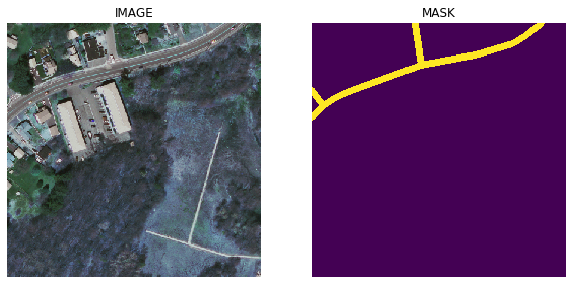

Image=250, 250 Mask=250, 250
1
Image: img-72_2.png


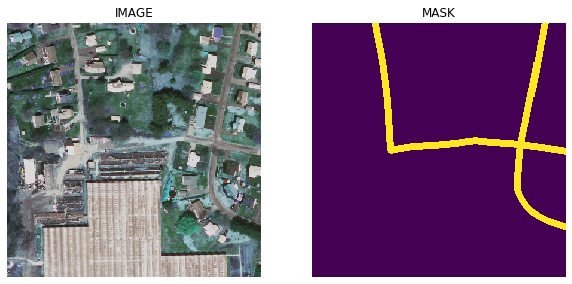

Image=250, 250 Mask=250, 250
2
Image: img-72_3.png


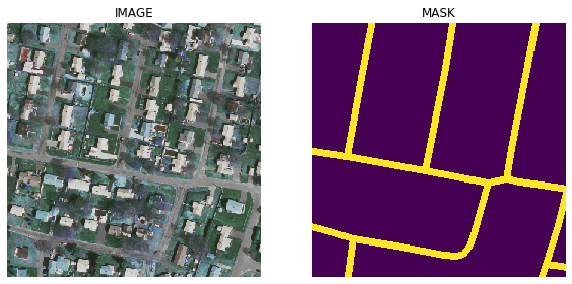

Image=250, 250 Mask=250, 250
3
Image: img-72_4.png


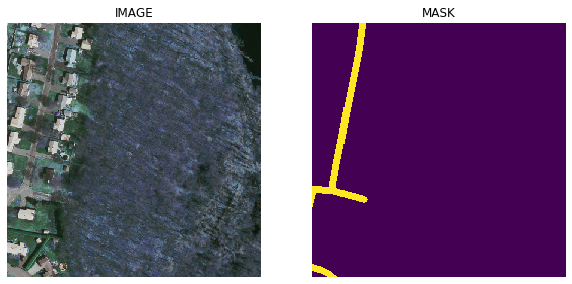

Image=250, 250 Mask=250, 250
4
Image: img-72_5.png
Image: img-72_5.png


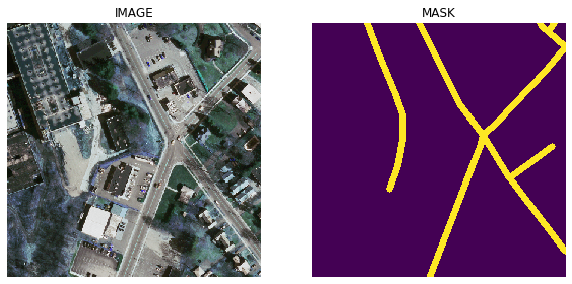

Image=250, 250 Mask=250, 250
5
Image: img-72_6.png
Image: img-72_6.png
Image: img-72_6.png


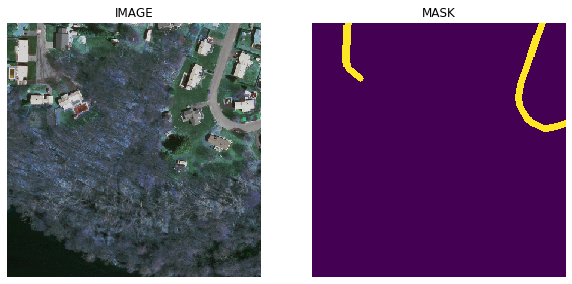

Image=250, 250 Mask=250, 250
6
Image: img-72_7.png
Image: img-72_7.png
Image: img-72_7.png


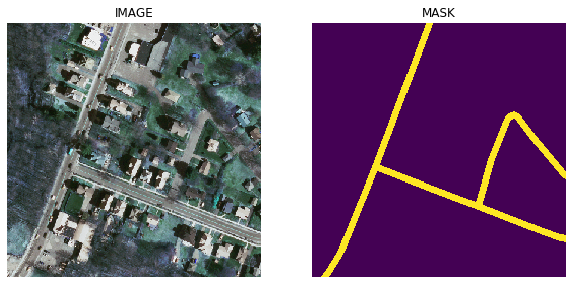

Image=250, 250 Mask=250, 250
7
Image: img-72_8.png


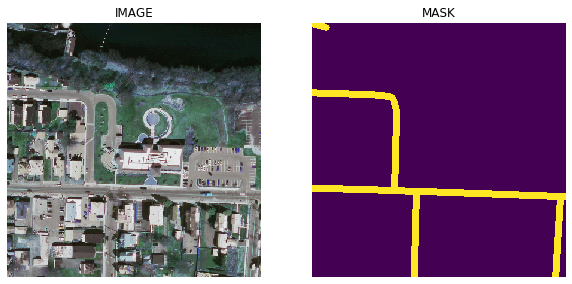

Image=250, 250 Mask=250, 250
8
Image: img-72_9.png


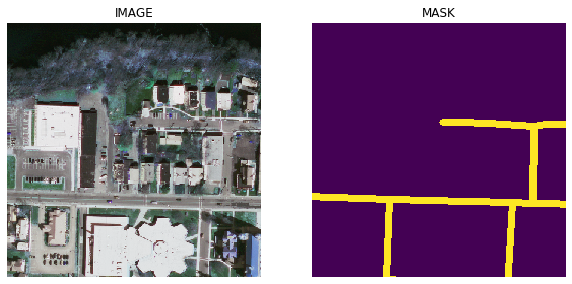

Image=250, 250 Mask=250, 250
9
Image: img-72_10.png


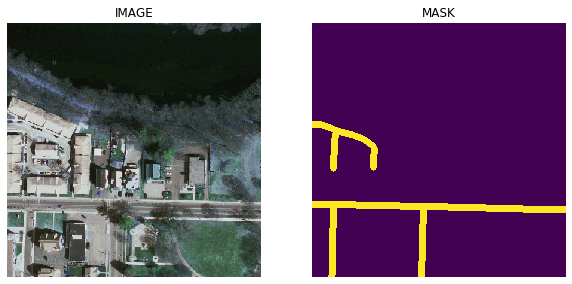

Image=250, 250 Mask=250, 250
10
Image: img-72_11.png


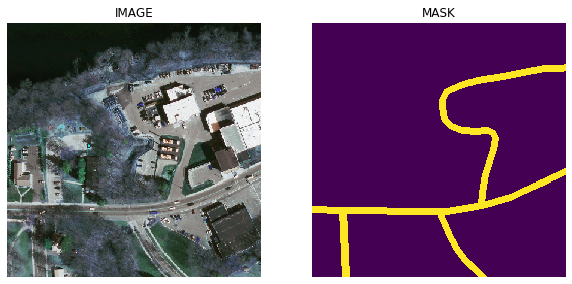

Image=250, 250 Mask=250, 250
11
Image: img-72_12.png


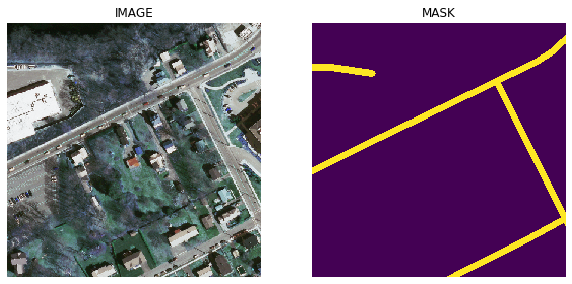

Image=250, 250 Mask=250, 250
12
Image: img-72_13.png


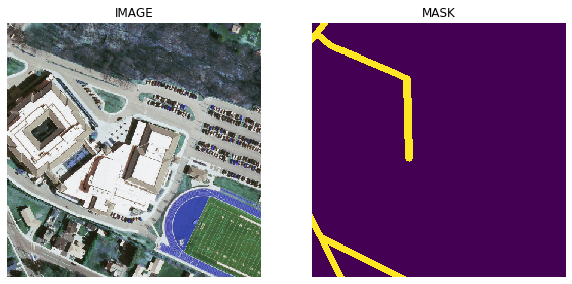

Image=250, 250 Mask=250, 250
13
Image: img-72_14.png


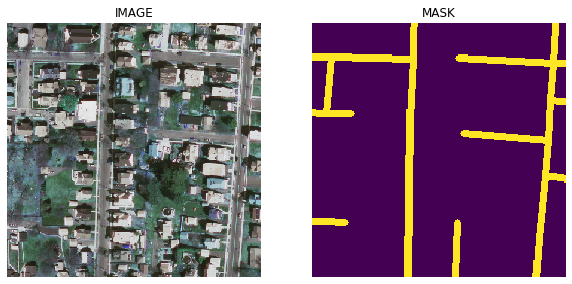

Image=250, 250 Mask=250, 250
14
Image: img-72_15.png


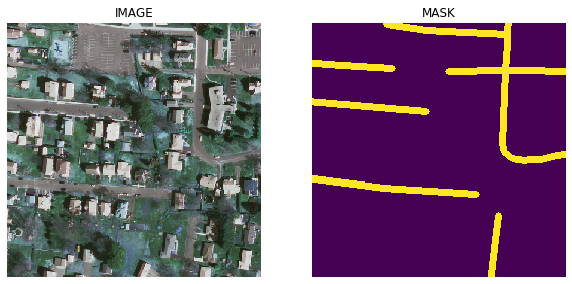

Image=250, 250 Mask=250, 250
15
Image: img-72_16.png


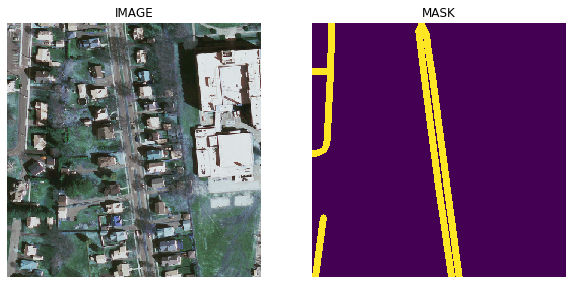

Image=250, 250 Mask=250, 250
16
Image: img-72_17.png


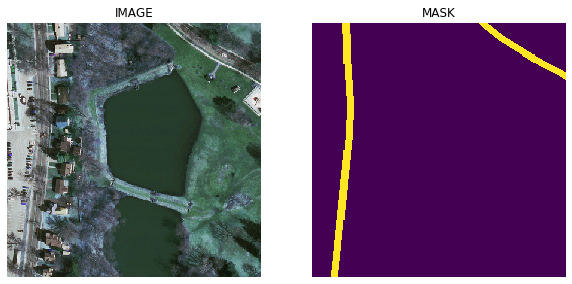

Image=250, 250 Mask=250, 250
17
Image: img-72_18.png


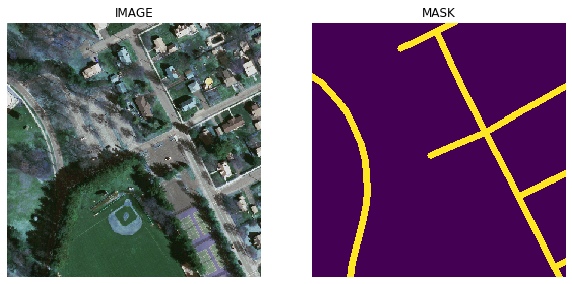

Image=250, 250 Mask=250, 250
18
Image: img-72_19.png


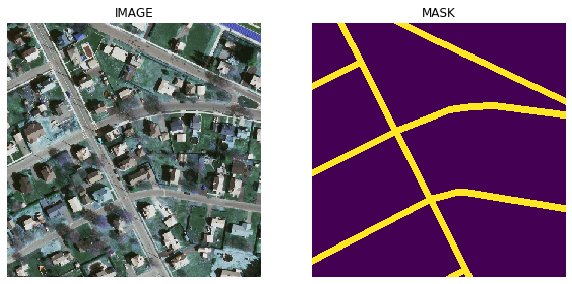

Image=250, 250 Mask=250, 250
19
Image: img-72_20.png


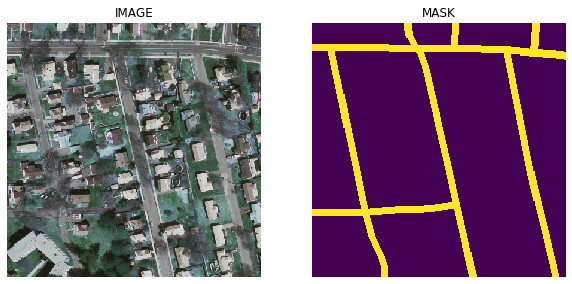

Image=250, 250 Mask=250, 250
20
Image: img-72_21.png


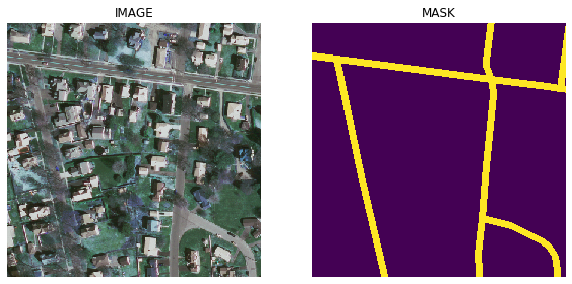

Image=250, 250 Mask=250, 250
21
Image: img-72_22.png


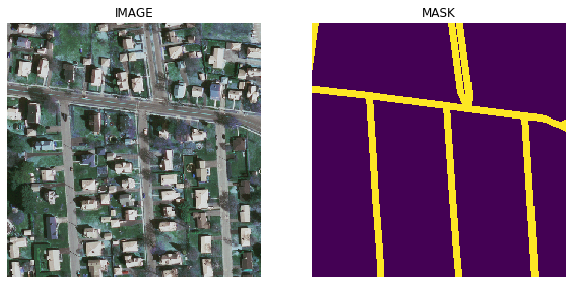

Image=250, 250 Mask=250, 250
22
Image: img-72_23.png


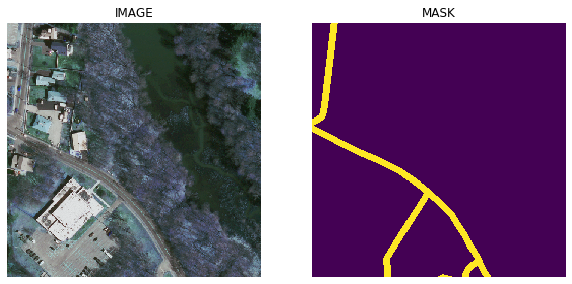

Image=250, 250 Mask=250, 250
23
Image: img-72_24.png


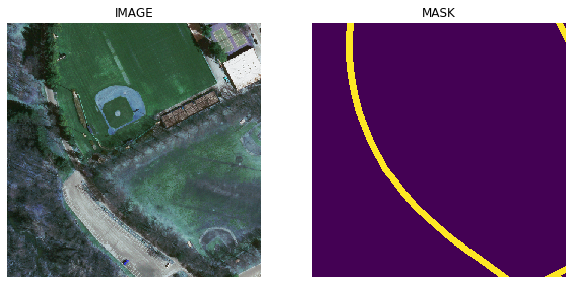

Image=250, 250 Mask=250, 250
24
Image: img-72_25.png


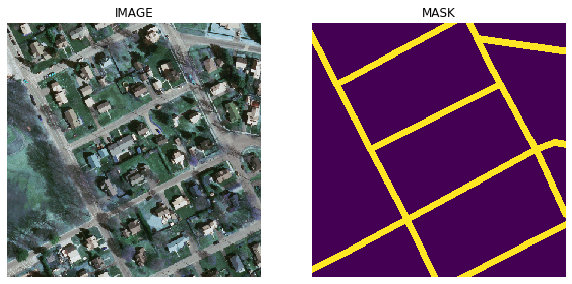

Image=250, 250 Mask=250, 250
25
Image: img-72_26.png


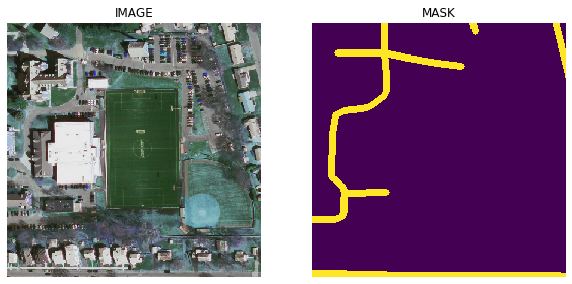

Image=250, 250 Mask=250, 250
26
Image: img-72_27.png


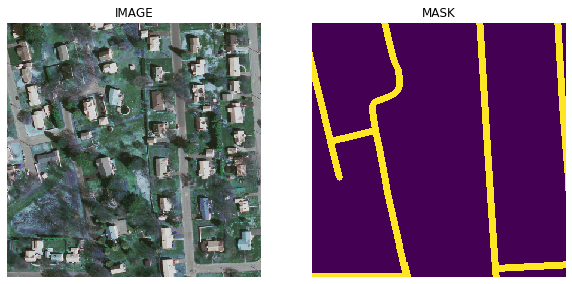

Image=250, 250 Mask=250, 250
27
Image: img-72_28.png


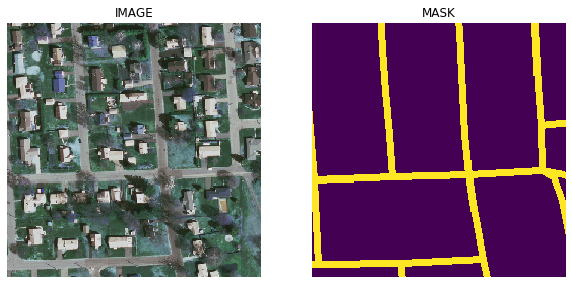

Image=250, 250 Mask=250, 250
28
Image: img-72_29.png


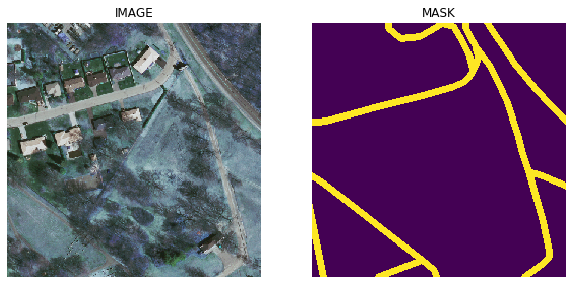

Image=250, 250 Mask=250, 250
29
Image: img-72_30.png


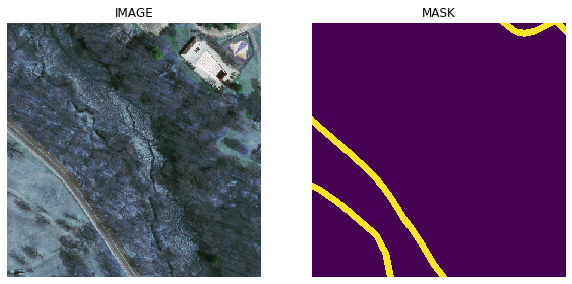

Image=250, 250 Mask=250, 250
30
Image: img-72_31.png


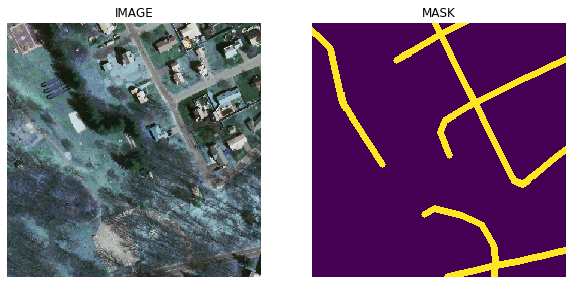

Image=250, 250 Mask=250, 250
31
Image: img-73_1.png


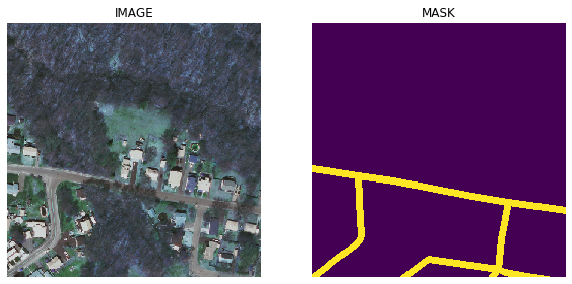

Image=250, 250 Mask=250, 250
1
Image: img-73_2.png


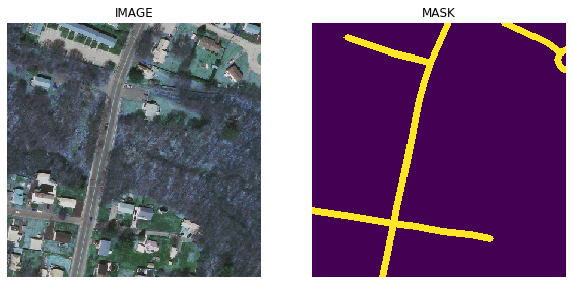

Image=250, 250 Mask=250, 250
2
Image: img-73_3.png
Image: img-73_3.png


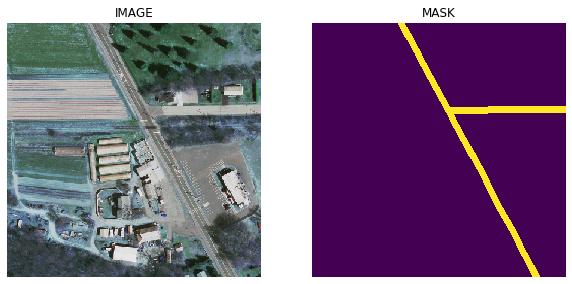

Image=250, 250 Mask=250, 250
3
Image: img-73_4.png


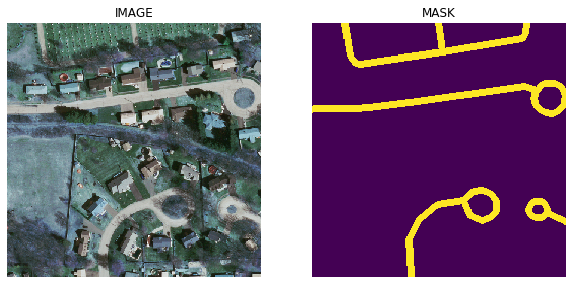

Image=250, 250 Mask=250, 250
4
Image: img-73_5.png


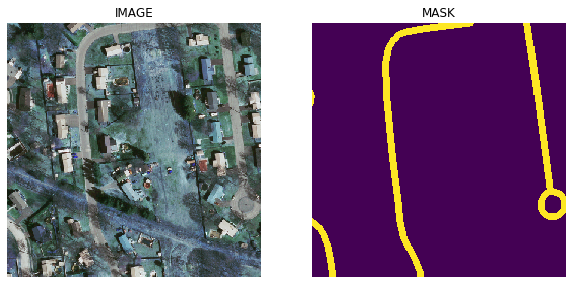

Image=250, 250 Mask=250, 250
5
Image: img-73_6.png


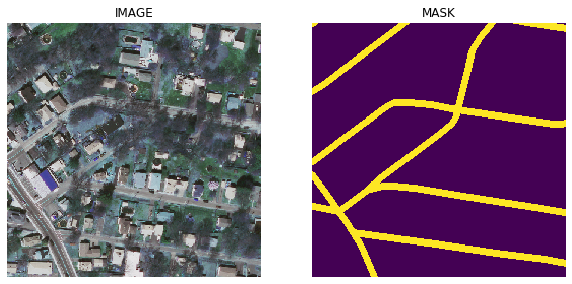

Image=250, 250 Mask=250, 250
6
Image: img-73_7.png


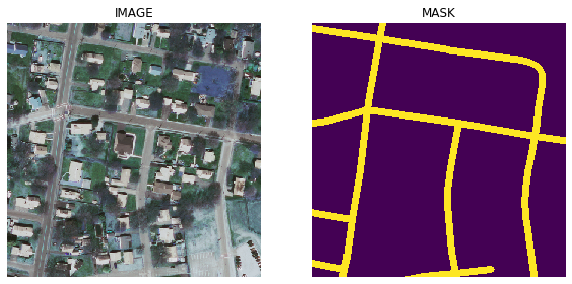

Image=250, 250 Mask=250, 250
7
Image: img-73_8.png


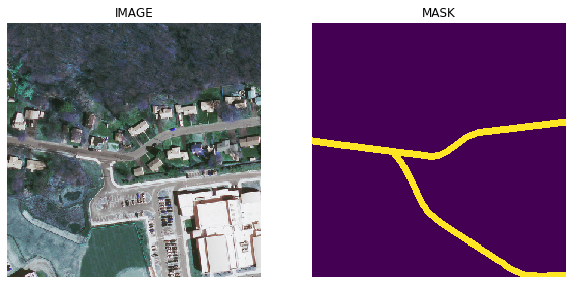

Image=250, 250 Mask=250, 250
8
Image: img-73_9.png


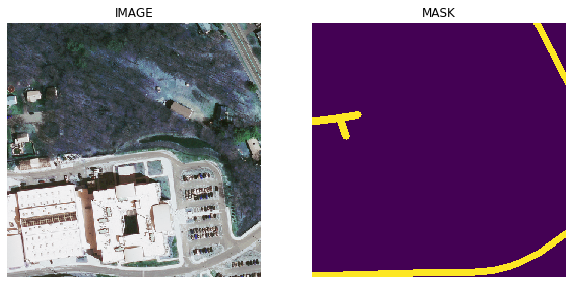

Image=250, 250 Mask=250, 250
9
Image: img-73_10.png


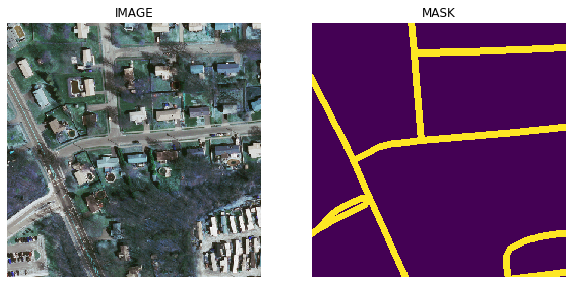

Image=250, 250 Mask=250, 250
10
Image: img-73_11.png


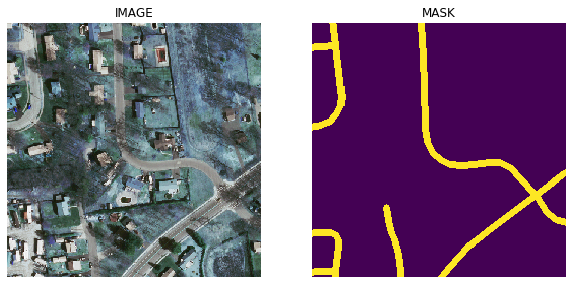

Image=250, 250 Mask=250, 250
11
Image: img-73_12.png


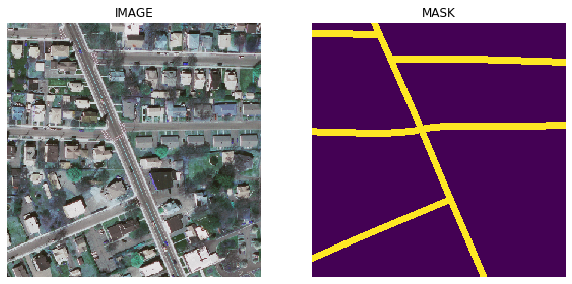

Image=250, 250 Mask=250, 250
12
Image: img-73_13.png


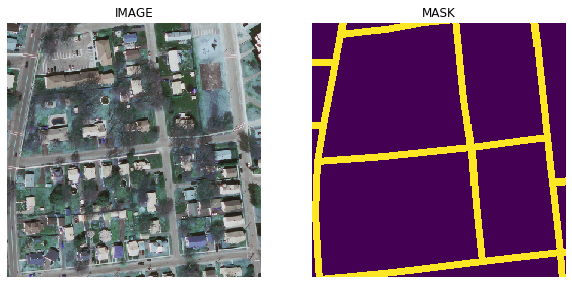

Image=250, 250 Mask=250, 250
13
Image: img-73_14.png


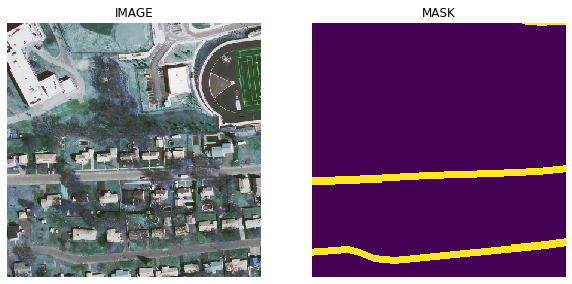

Image=250, 250 Mask=250, 250
14
Image: img-73_15.png


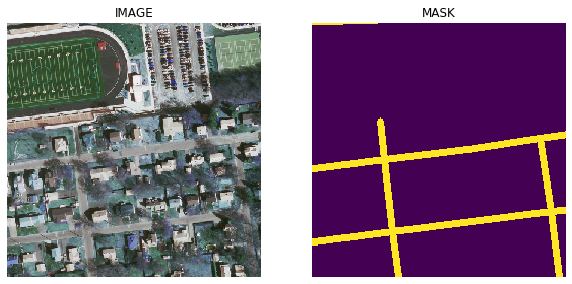

Image=250, 250 Mask=250, 250
15
Image: img-73_16.png


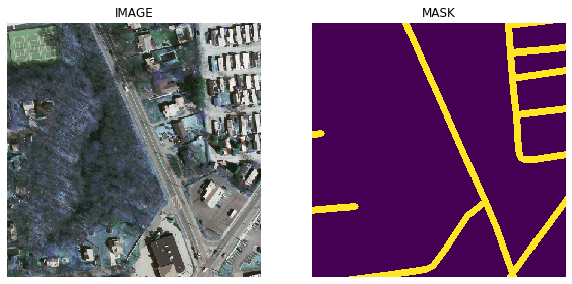

Image=250, 250 Mask=250, 250
16
Image: img-73_17.png


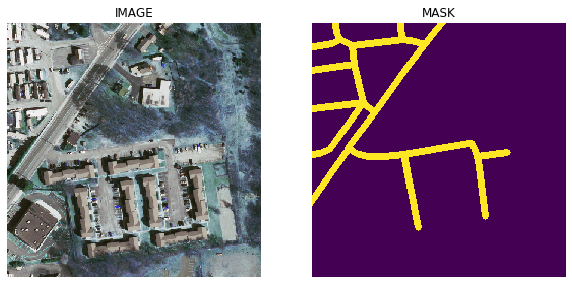

Image=250, 250 Mask=250, 250
17
Image: img-73_18.png


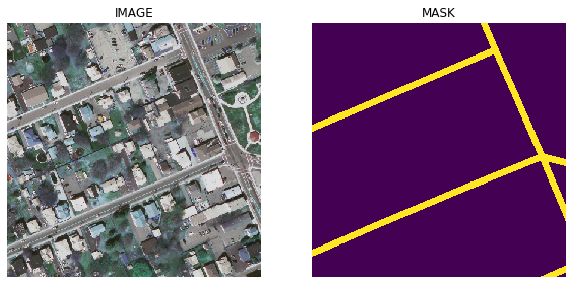

Image=250, 250 Mask=250, 250
18
Image: img-73_19.png


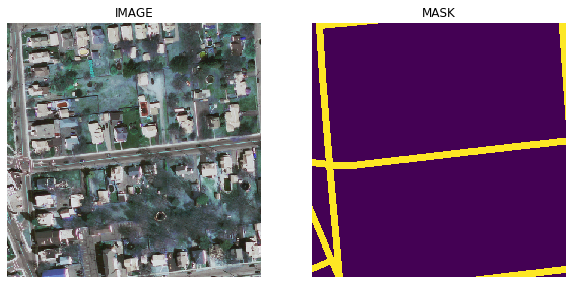

Image=250, 250 Mask=250, 250
19
Image: img-73_20.png


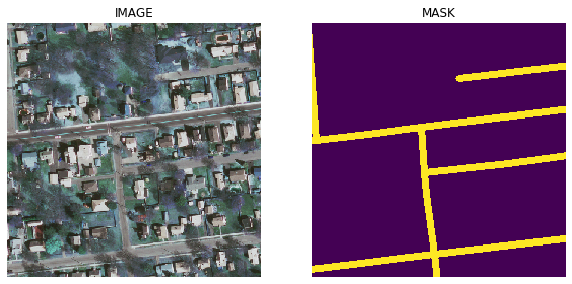

Image=250, 250 Mask=250, 250
20
Image: img-73_21.png


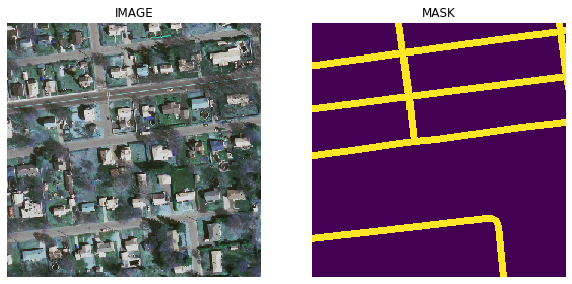

Image=250, 250 Mask=250, 250
21
Image: img-73_22.png


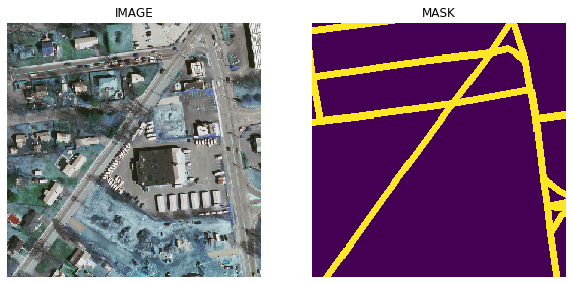

Image=250, 250 Mask=250, 250
22
Image: img-73_23.png


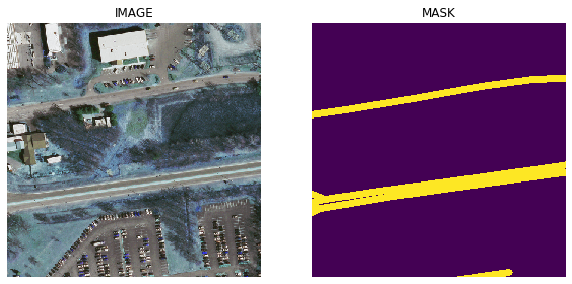

Image=250, 250 Mask=250, 250
23
Image: img-73_24.png


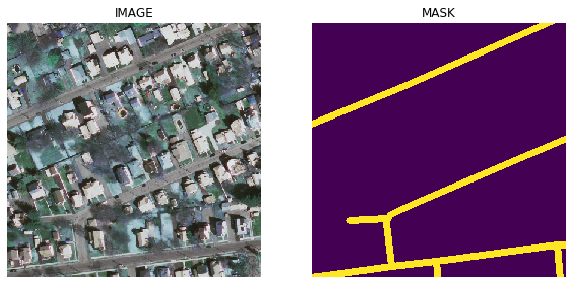

Image=250, 250 Mask=250, 250
24
Image: img-73_25.png


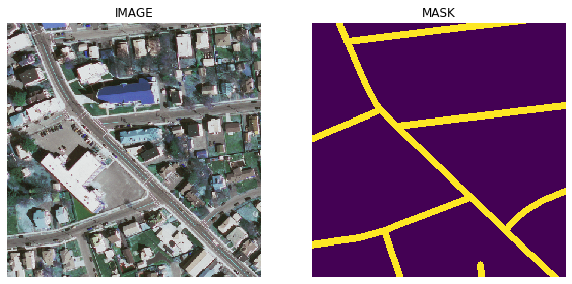

Image=250, 250 Mask=250, 250
25
Image: img-73_26.png


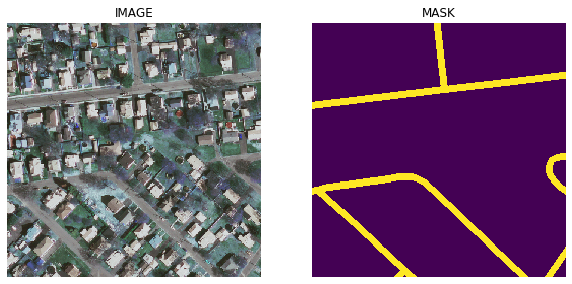

Image=250, 250 Mask=250, 250
26
Image: img-73_27.png


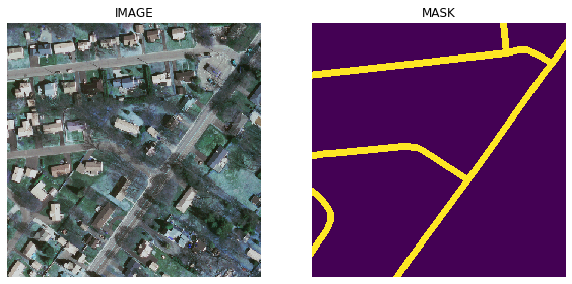

Image=250, 250 Mask=250, 250
27
Image: img-73_28.png
Image: img-73_28.png


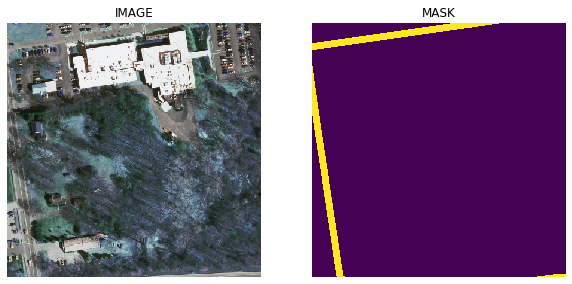

Image=250, 250 Mask=250, 250
28
Image: img-73_29.png


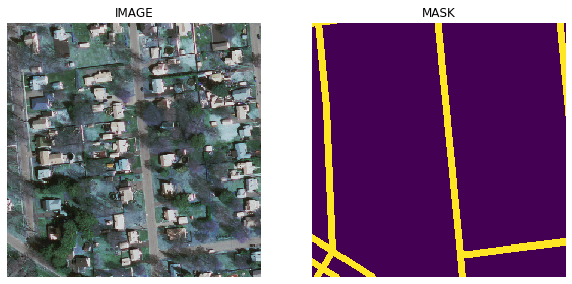

Image=250, 250 Mask=250, 250
29
Image: img-73_30.png


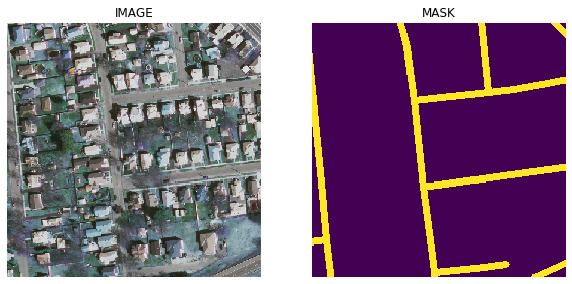

Image=250, 250 Mask=250, 250
30
Image: img-73_31.png


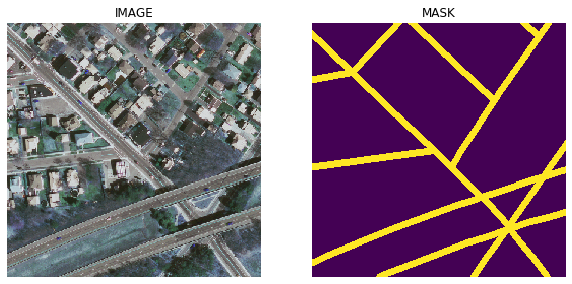

Image=250, 250 Mask=250, 250
31
Image: img-73_32.png


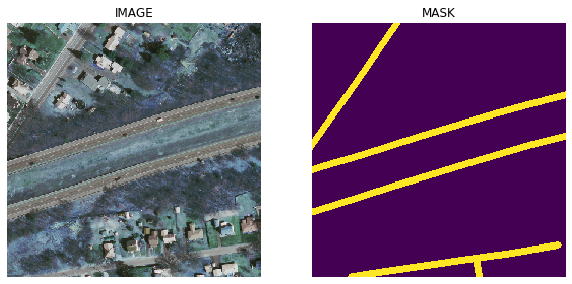

Image=250, 250 Mask=250, 250
32
Image: img-73_33.png


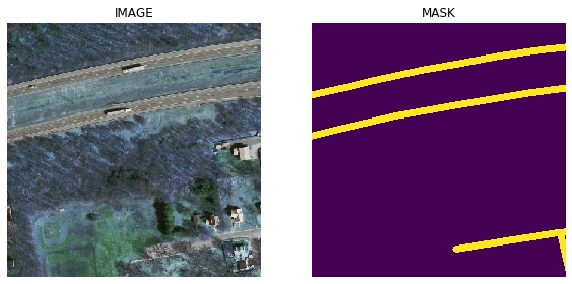

Image=250, 250 Mask=250, 250
33
Image: img-73_34.png


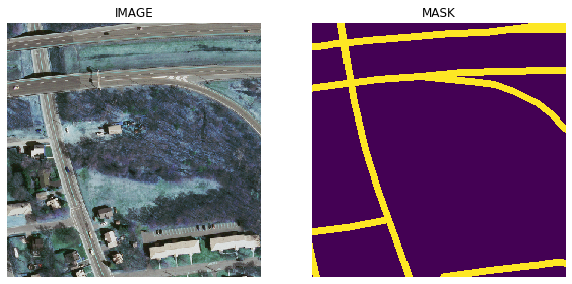

Image=250, 250 Mask=250, 250
34
Image: img-74_1.png


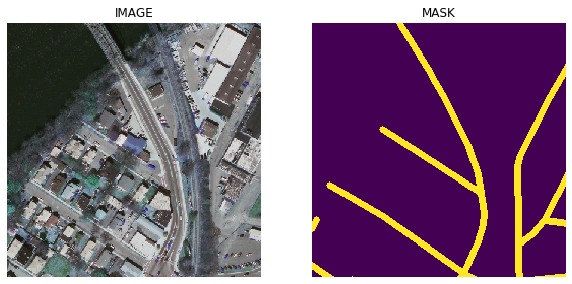

Image=250, 250 Mask=250, 250
1
Image: img-74_2.png


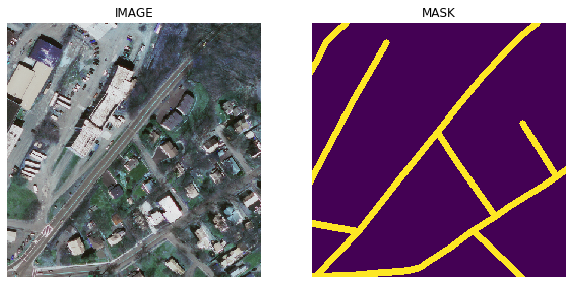

Image=250, 250 Mask=250, 250
2
Image: img-74_3.png


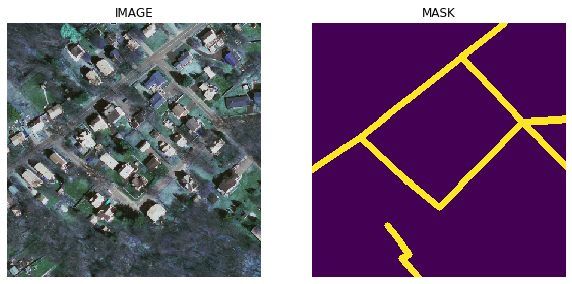

Image=250, 250 Mask=250, 250
3
Image: img-74_4.png


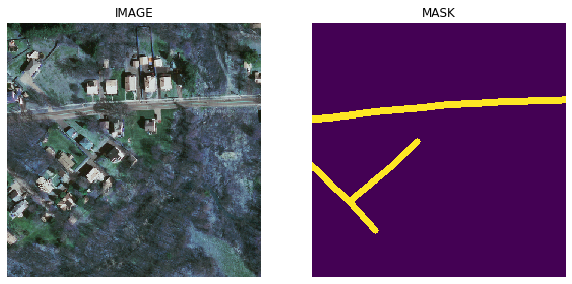

Image=250, 250 Mask=250, 250
4
Image: img-74_5.png


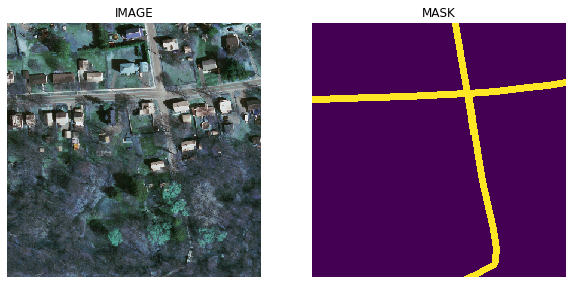

Image=250, 250 Mask=250, 250
5
Image: img-74_6.png


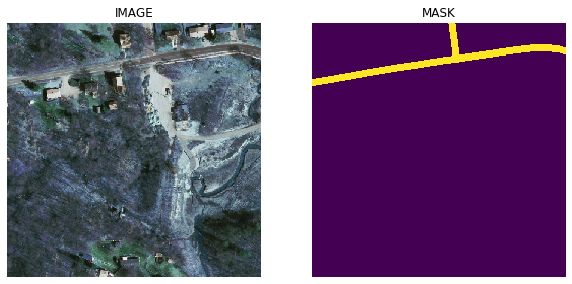

Image=250, 250 Mask=250, 250
6
Image: img-74_7.png


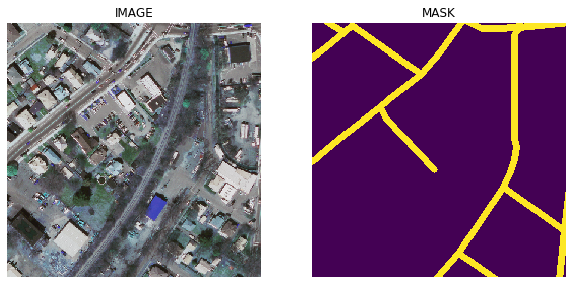

Image=250, 250 Mask=250, 250
7
Image: img-74_8.png


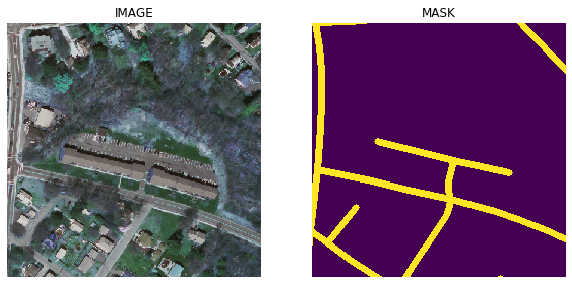

Image=250, 250 Mask=250, 250
8
Image: img-74_9.png


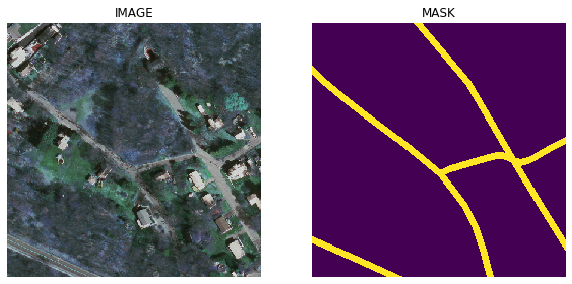

Image=250, 250 Mask=250, 250
9
Image: img-74_10.png


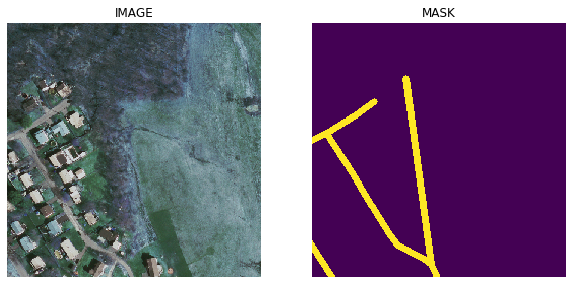

Image=250, 250 Mask=250, 250
10
Image: img-74_11.png


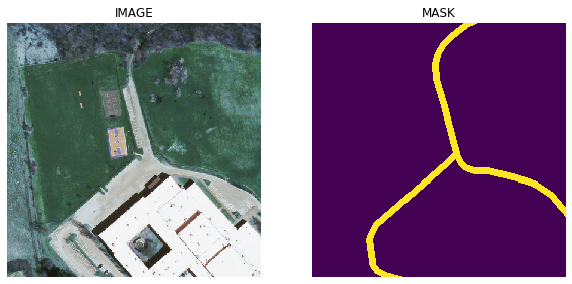

Image=250, 250 Mask=250, 250
11
Image: img-74_12.png


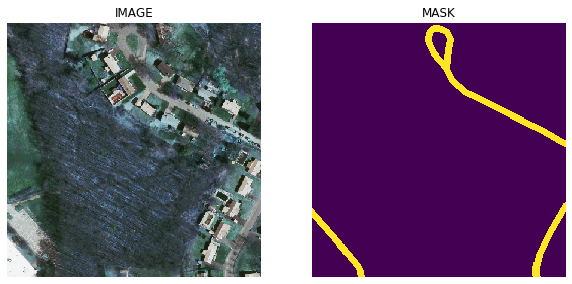

Image=250, 250 Mask=250, 250
12
Image: img-74_13.png


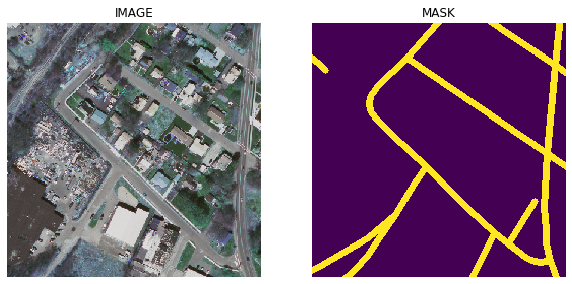

Image=250, 250 Mask=250, 250
13
Image: img-74_14.png


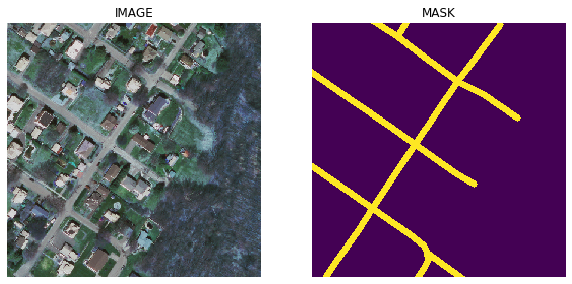

Image=250, 250 Mask=250, 250
14
Image: img-74_15.png


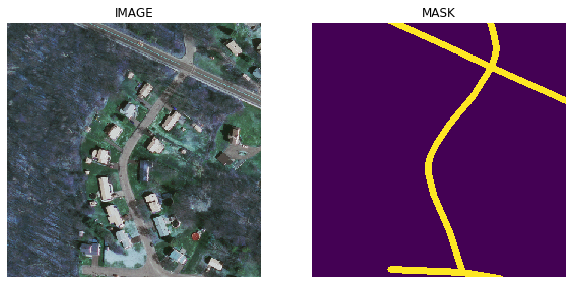

Image=250, 250 Mask=250, 250
15
Image: img-74_16.png


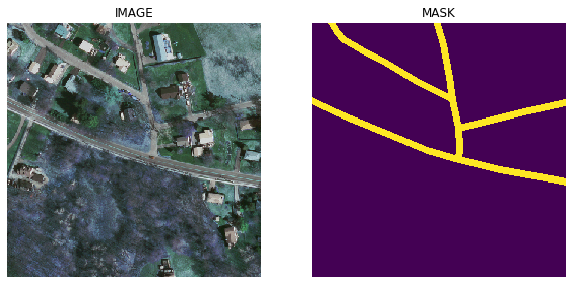

Image=250, 250 Mask=250, 250
16
Image: img-74_17.png


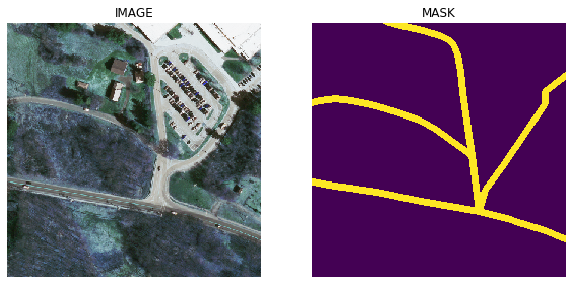

Image=250, 250 Mask=250, 250
17
Image: img-74_18.png


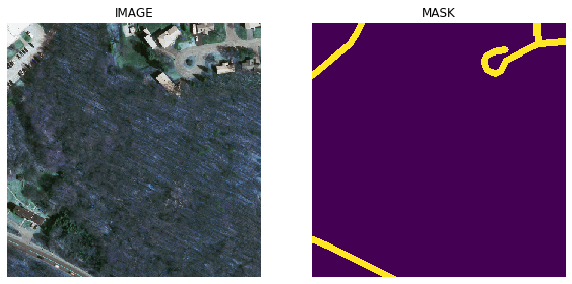

Image=250, 250 Mask=250, 250
18
Image: img-74_19.png


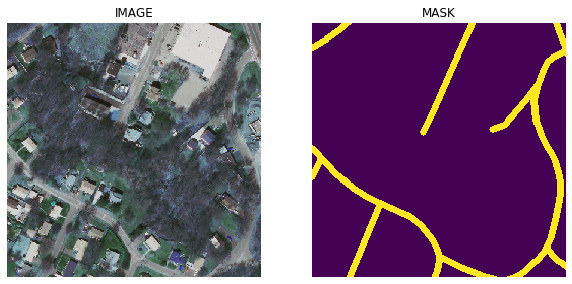

Image=250, 250 Mask=250, 250
19
Image: img-74_20.png


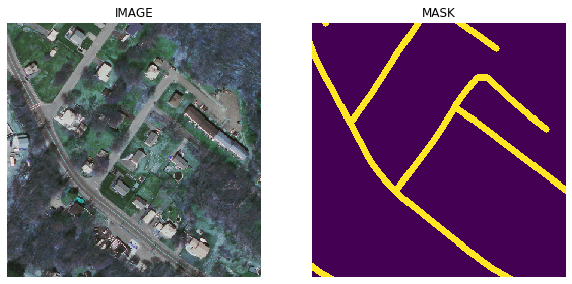

Image=250, 250 Mask=250, 250
20
Image: img-74_21.png


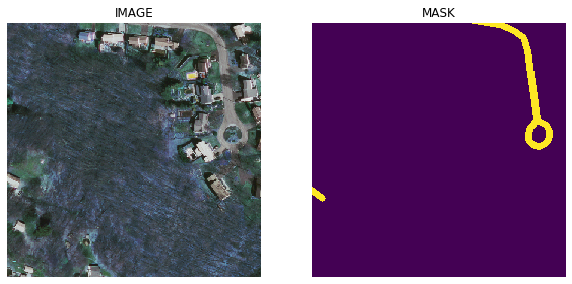

Image=250, 250 Mask=250, 250
21
Image: img-74_22.png


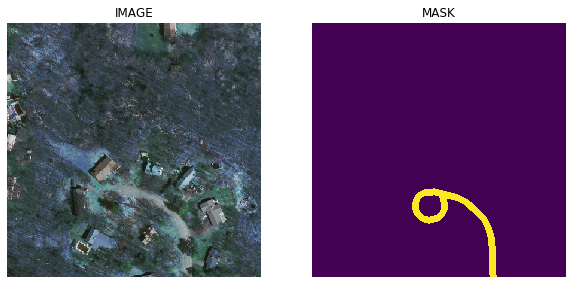

Image=250, 250 Mask=250, 250
22
Image: img-74_23.png
Image: img-74_23.png


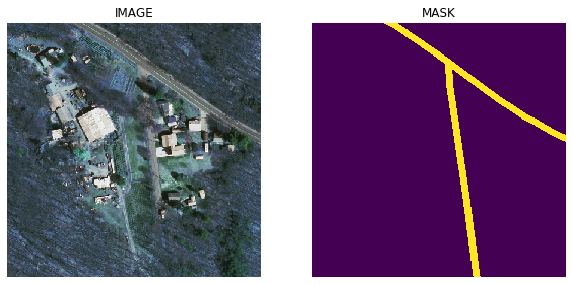

Image=250, 250 Mask=250, 250
23
Image: img-74_24.png


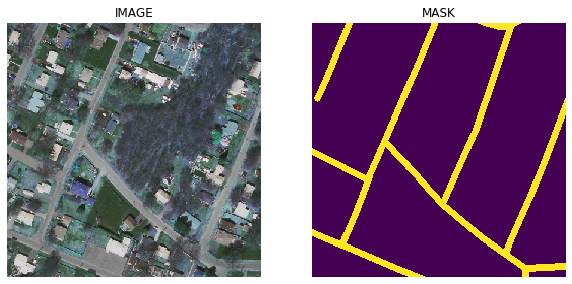

Image=250, 250 Mask=250, 250
24
Image: img-74_25.png


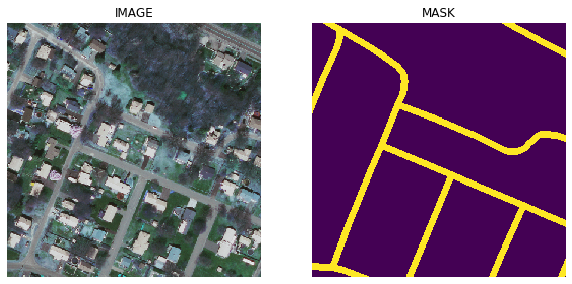

Image=250, 250 Mask=250, 250
25
Image: img-74_26.png


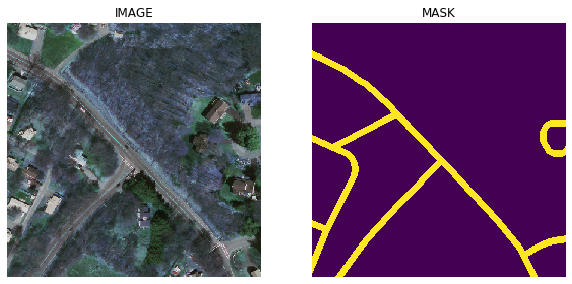

Image=250, 250 Mask=250, 250
26
Image: img-74_27.png


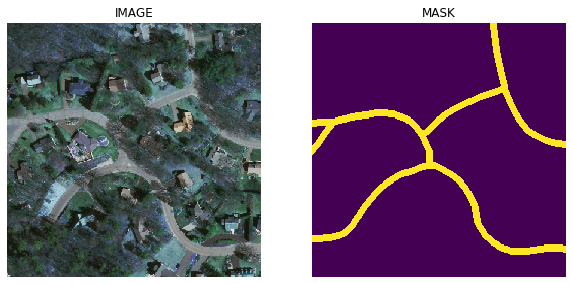

Image=250, 250 Mask=250, 250
27
Image: img-74_28.png


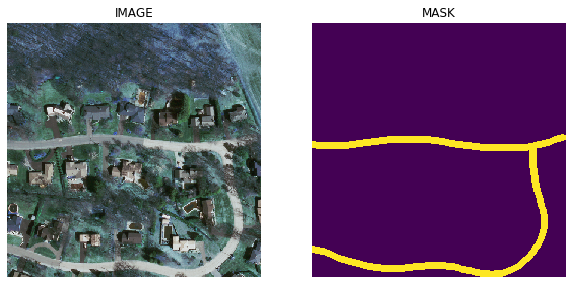

Image=250, 250 Mask=250, 250
28
Image: img-74_29.png


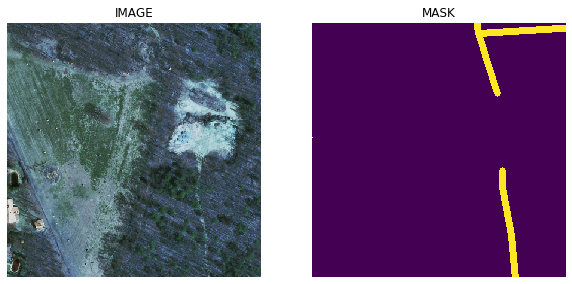

Image=250, 250 Mask=250, 250
29
Image: img-74_30.png


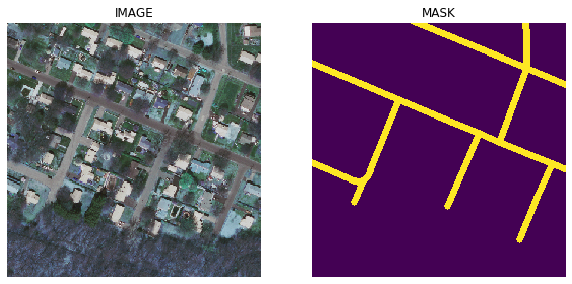

Image=250, 250 Mask=250, 250
30
Image: img-74_31.png


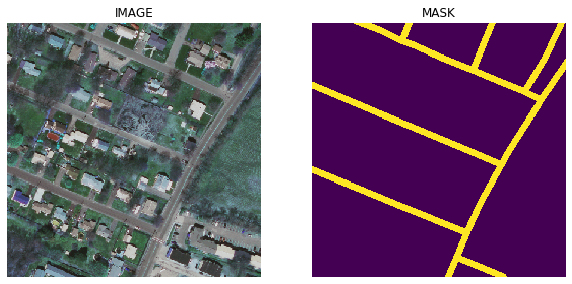

Image=250, 250 Mask=250, 250
31
Image: img-74_32.png
Image: img-74_32.png


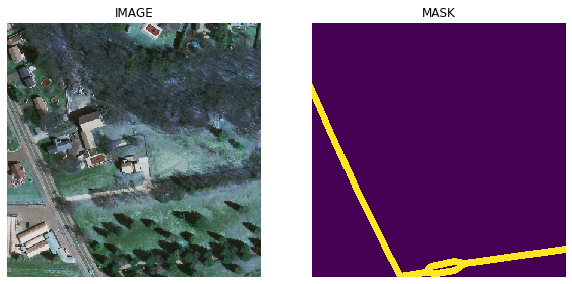

Image=250, 250 Mask=250, 250
32
Image: img-74_33.png


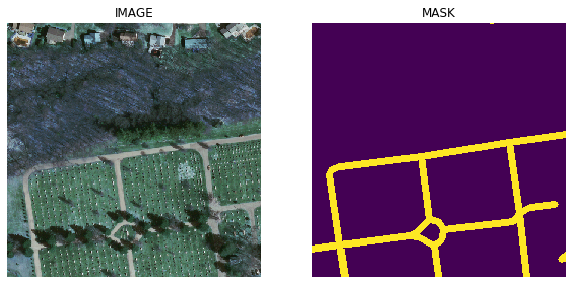

Image=250, 250 Mask=250, 250
33
Image: img-74_34.png


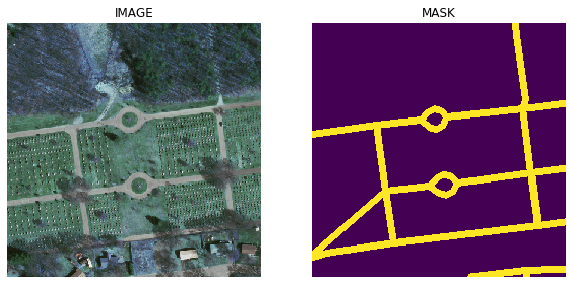

Image=250, 250 Mask=250, 250
34
Image: img-77_1.png
Image: img-77_1.png
Image: img-77_1.png


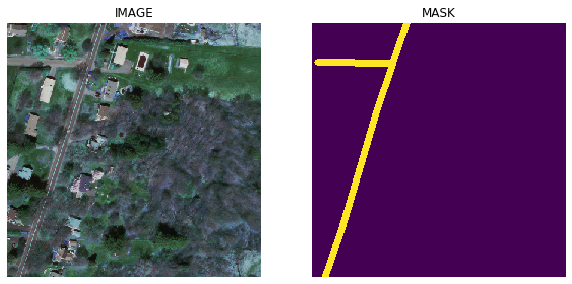

Image=250, 250 Mask=250, 250
1
Image: img-77_2.png
Image: img-77_2.png


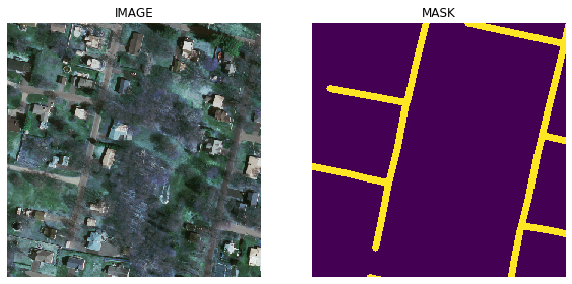

Image=250, 250 Mask=250, 250
2
Image: img-77_3.png


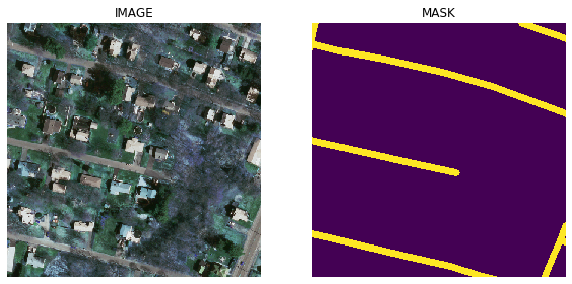

Image=250, 250 Mask=250, 250
3
Image: img-77_4.png


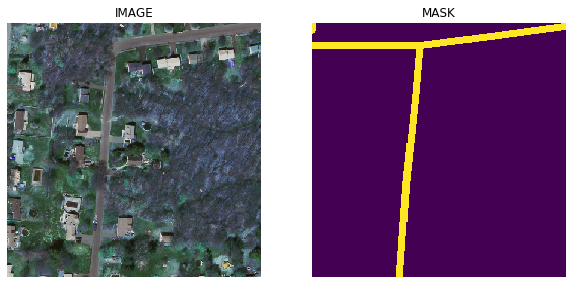

Image=250, 250 Mask=250, 250
4
Image: img-77_5.png


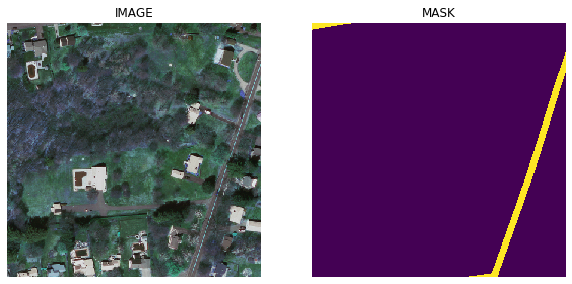

Image=250, 250 Mask=250, 250
5
Image: img-77_6.png
Image: img-77_6.png
Image: img-77_6.png


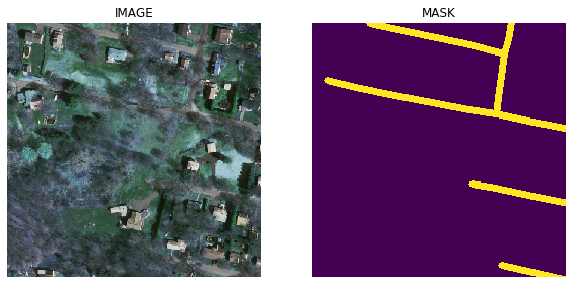

Image=250, 250 Mask=250, 250
6
Image: img-77_7.png


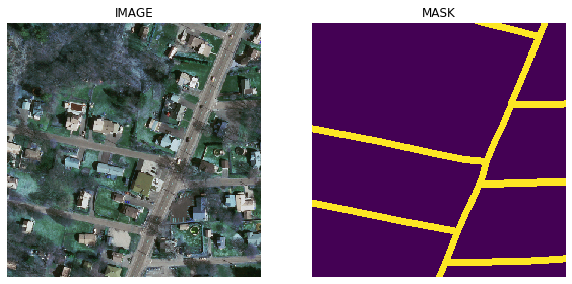

Image=250, 250 Mask=250, 250
7
Image: img-77_8.png


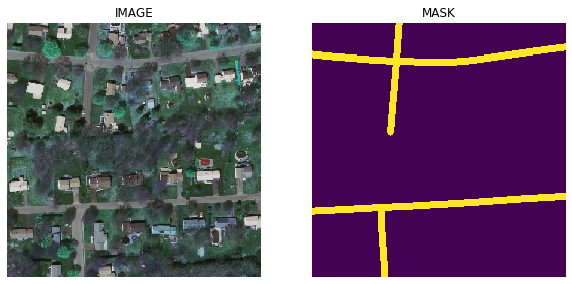

Image=250, 250 Mask=250, 250
8
Image: img-77_9.png


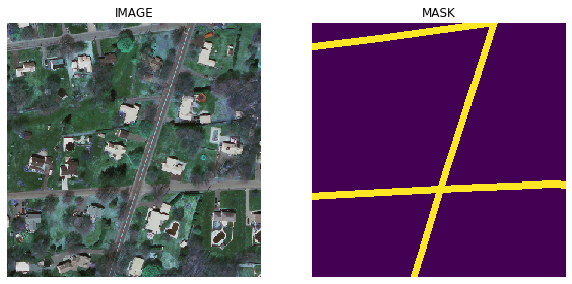

Image=250, 250 Mask=250, 250
9
Image: img-77_10.png
Image: img-77_10.png
Image: img-77_10.png


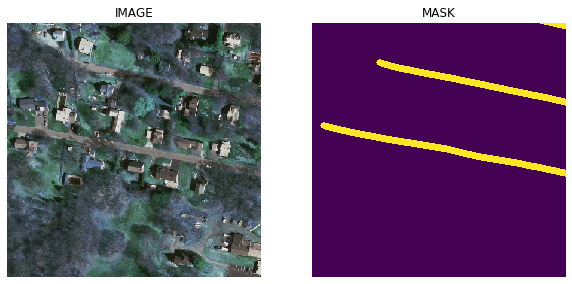

Image=250, 250 Mask=250, 250
10
Image: img-77_11.png


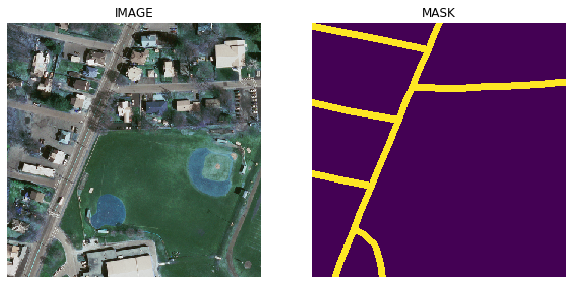

Image=250, 250 Mask=250, 250
11
Image: img-77_12.png


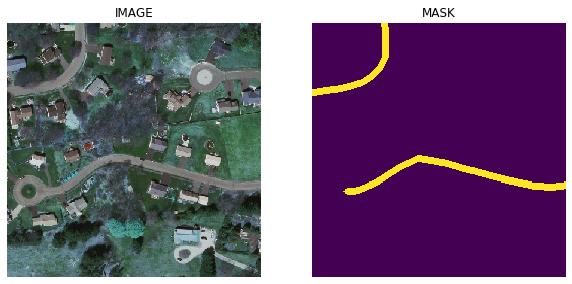

Image=250, 250 Mask=250, 250
12
Image: img-77_13.png


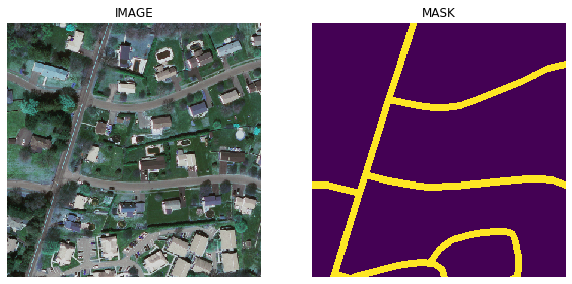

Image=250, 250 Mask=250, 250
13
Image: img-77_14.png


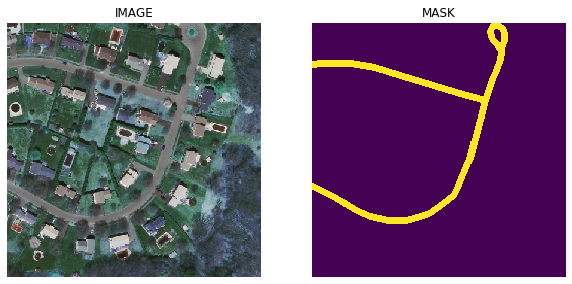

Image=250, 250 Mask=250, 250
14
Image: img-77_15.png
Image: img-77_15.png


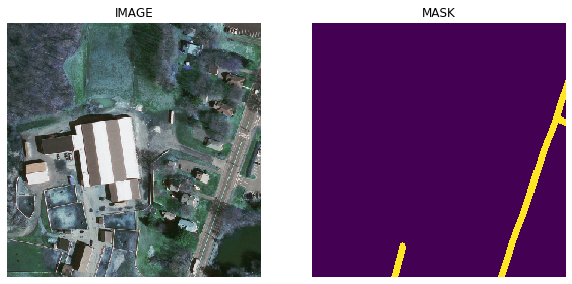

Image=250, 250 Mask=250, 250
15
Image: img-77_16.png


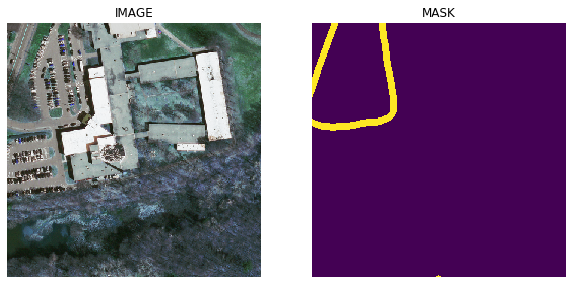

Image=250, 250 Mask=250, 250
16
Image: img-77_17.png


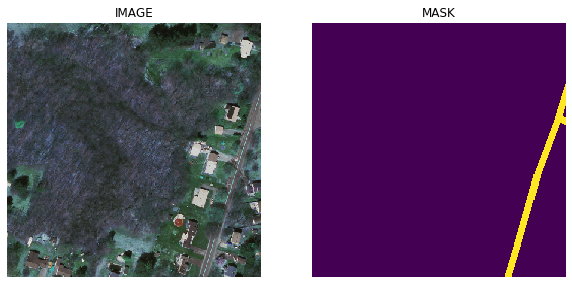

Image=250, 250 Mask=250, 250
17
Image: img-77_18.png


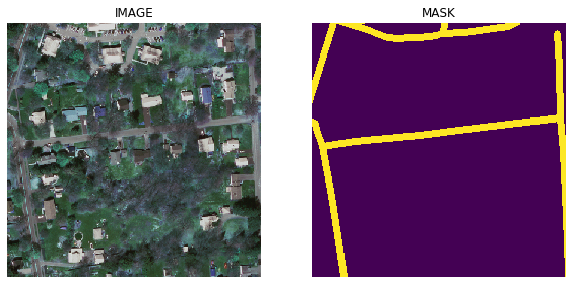

Image=250, 250 Mask=250, 250
18
Image: img-77_19.png


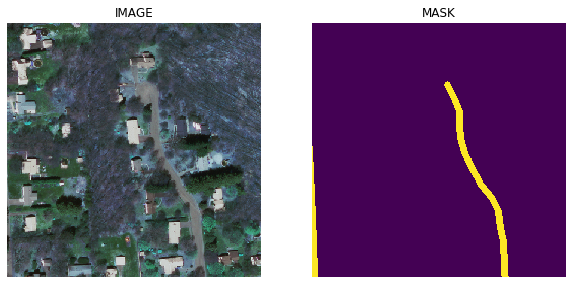

Image=250, 250 Mask=250, 250
19
Image: img-77_20.png
Image: img-77_20.png


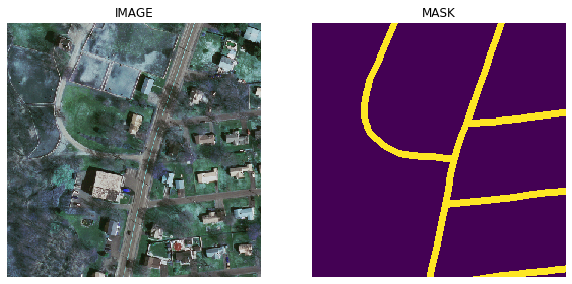

Image=250, 250 Mask=250, 250
20
Image: img-77_21.png


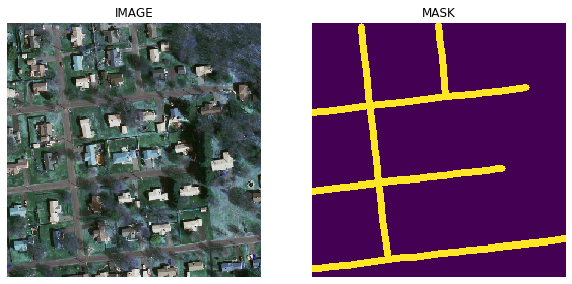

Image=250, 250 Mask=250, 250
21
Image: img-77_22.png


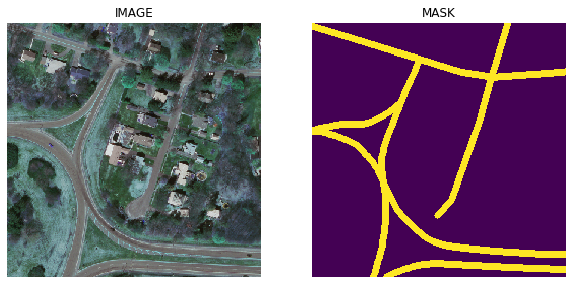

Image=250, 250 Mask=250, 250
22
Image: img-77_23.png


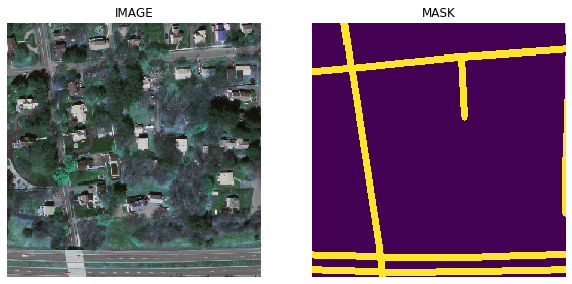

Image=250, 250 Mask=250, 250
23
Image: img-77_24.png


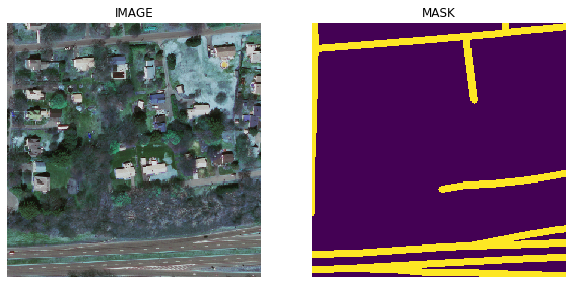

Image=250, 250 Mask=250, 250
24
Image: img-77_25.png


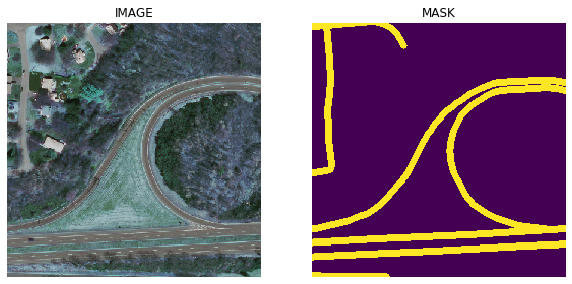

Image=250, 250 Mask=250, 250
25
Image: img-77_26.png


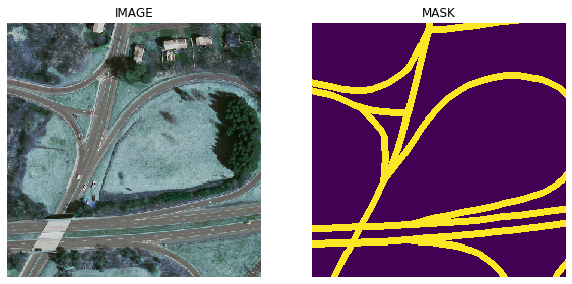

Image=250, 250 Mask=250, 250
26
Image: img-77_27.png


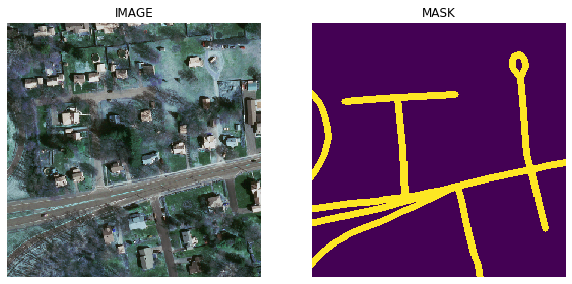

Image=250, 250 Mask=250, 250
27
Image: img-78_1.png


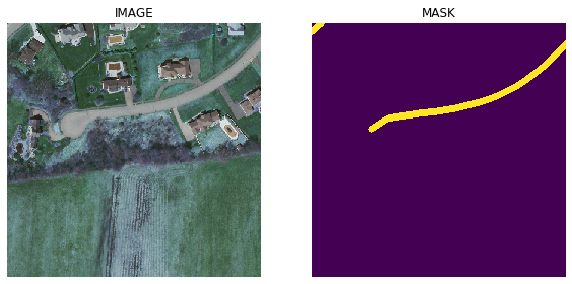

Image=250, 250 Mask=250, 250
1
Image: img-78_2.png


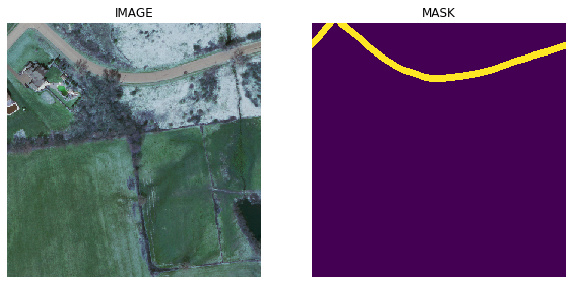

Image=250, 250 Mask=250, 250
2
Image: img-78_3.png


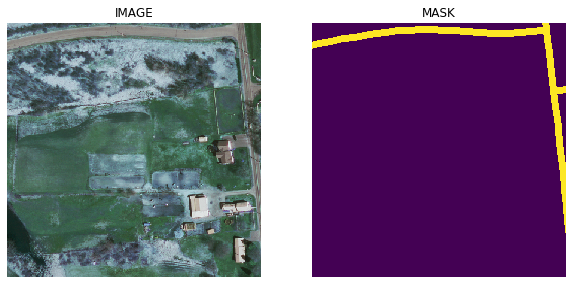

Image=250, 250 Mask=250, 250
3
Image: img-78_4.png


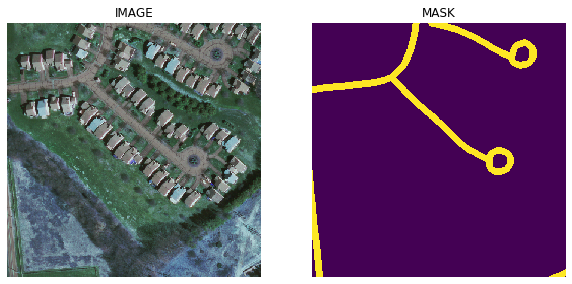

Image=250, 250 Mask=250, 250
4
Image: img-78_5.png
Image: img-78_5.png
Image: img-78_5.png
Image: img-78_5.png
Image: img-78_5.png
Image: img-78_5.png


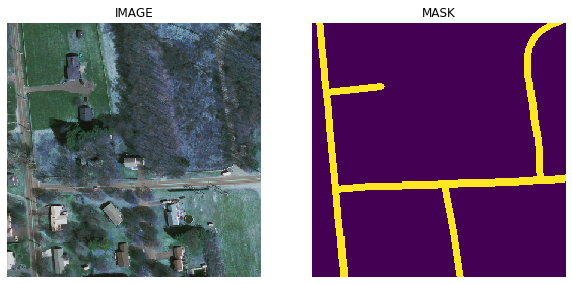

Image=250, 250 Mask=250, 250
5
Image: img-78_6.png


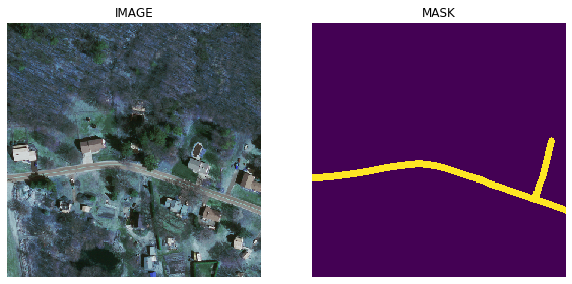

Image=250, 250 Mask=250, 250
6
Image: img-78_7.png


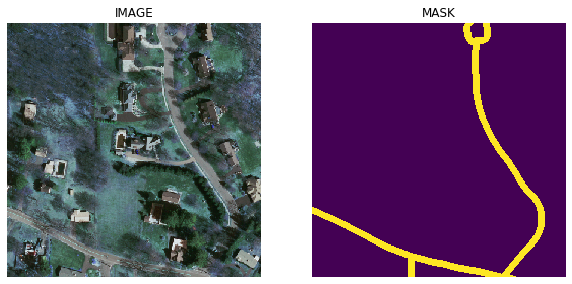

Image=250, 250 Mask=250, 250
7
Image: img-78_8.png


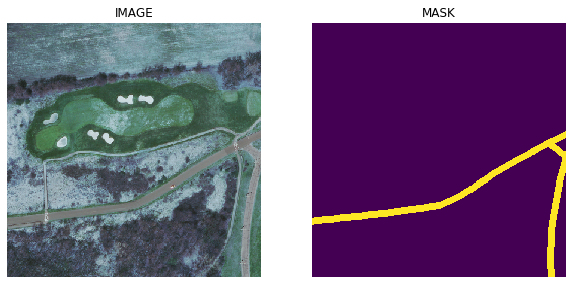

Image=250, 250 Mask=250, 250
8
Image: img-78_9.png


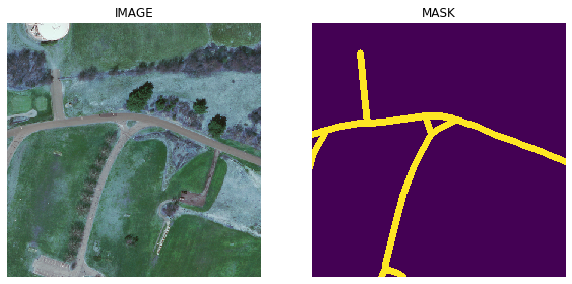

Image=250, 250 Mask=250, 250
9
Image: img-78_10.png


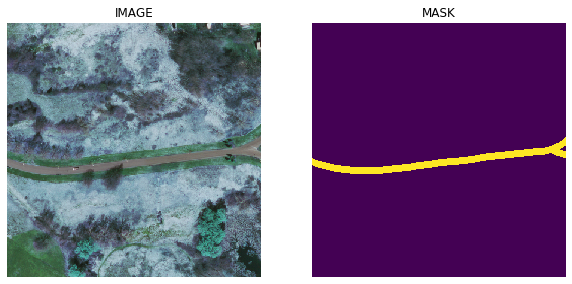

Image=250, 250 Mask=250, 250
10
Image: img-78_11.png


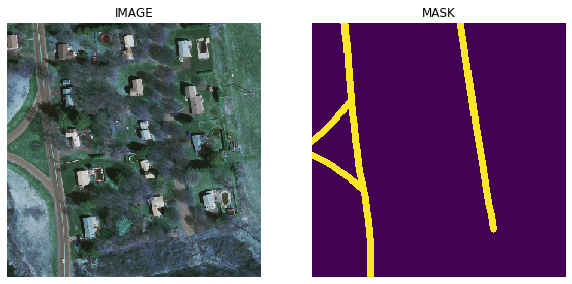

Image=250, 250 Mask=250, 250
11
Image: img-78_12.png


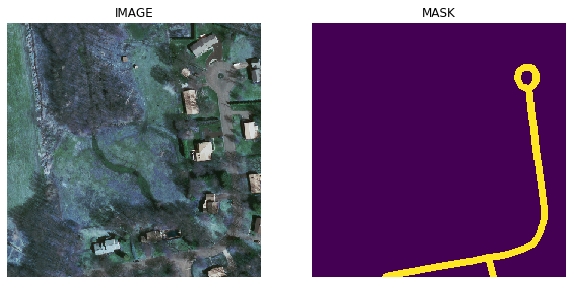

Image=250, 250 Mask=250, 250
12
Image: img-78_13.png


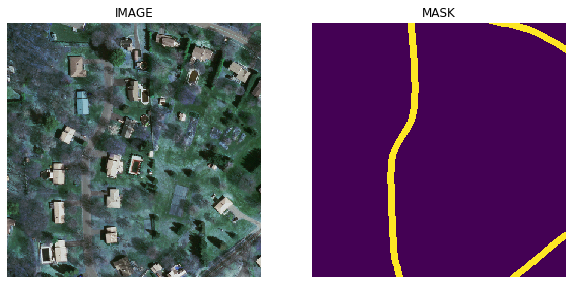

Image=250, 250 Mask=250, 250
13
Image: img-78_14.png
Image: img-78_14.png
Image: img-78_14.png
Image: img-78_14.png


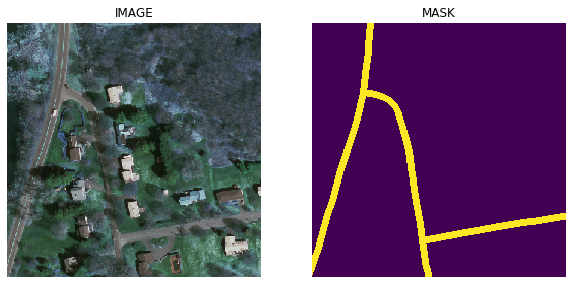

Image=250, 250 Mask=250, 250
14
Image: img-78_15.png


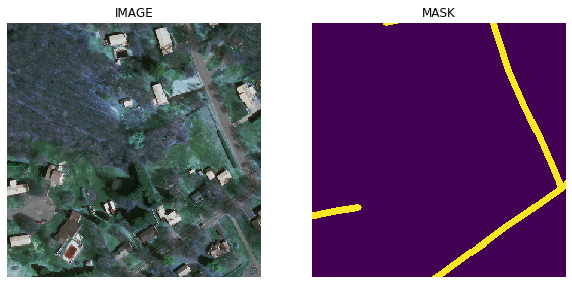

Image=250, 250 Mask=250, 250
15
Image: img-78_16.png


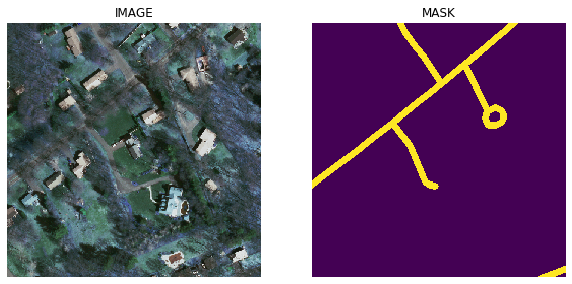

Image=250, 250 Mask=250, 250
16
Image: img-78_17.png


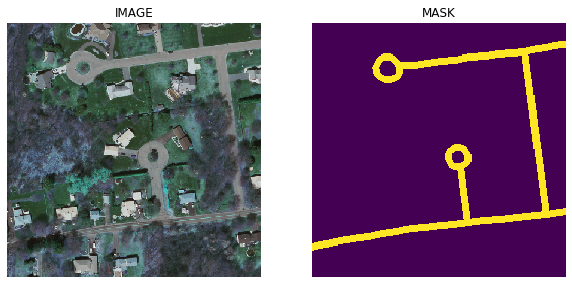

Image=250, 250 Mask=250, 250
17
Image: img-78_18.png


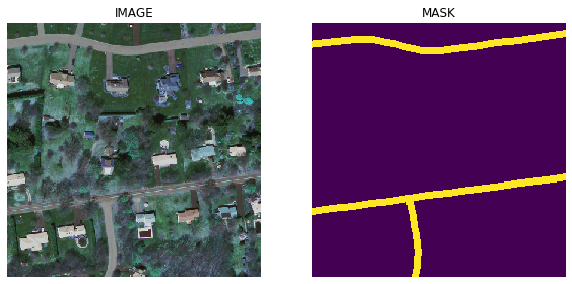

Image=250, 250 Mask=250, 250
18
Image: img-78_19.png


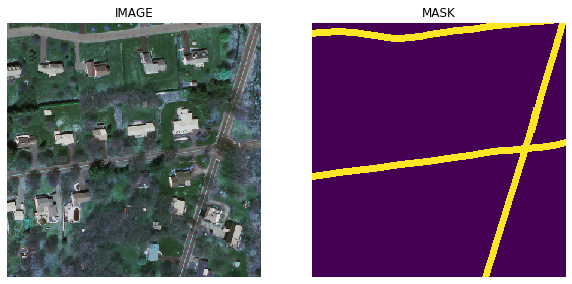

Image=250, 250 Mask=250, 250
19
Image: img-78_20.png


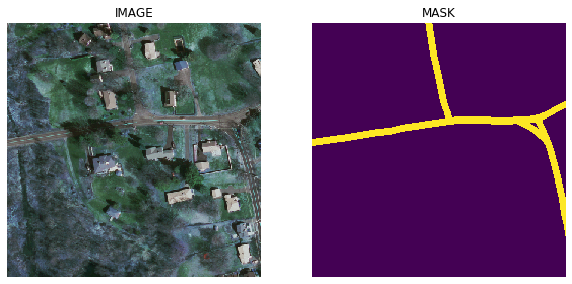

Image=250, 250 Mask=250, 250
20
Image: img-78_21.png


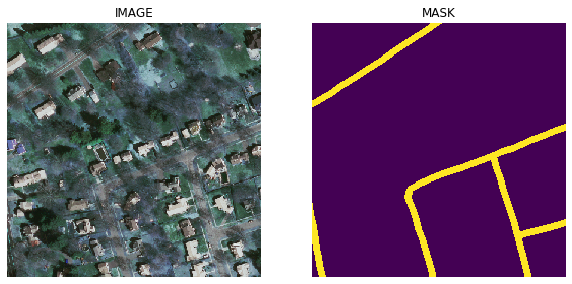

Image=250, 250 Mask=250, 250
21
Image: img-78_22.png


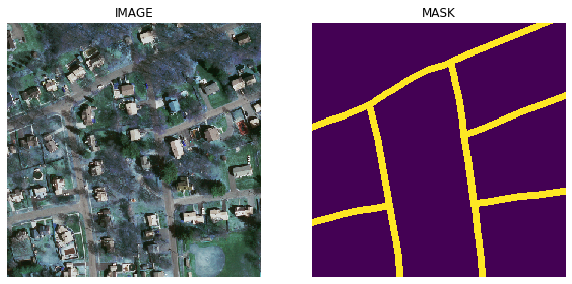

Image=250, 250 Mask=250, 250
22
Image: img-78_23.png
Image: img-78_23.png
Image: img-78_23.png


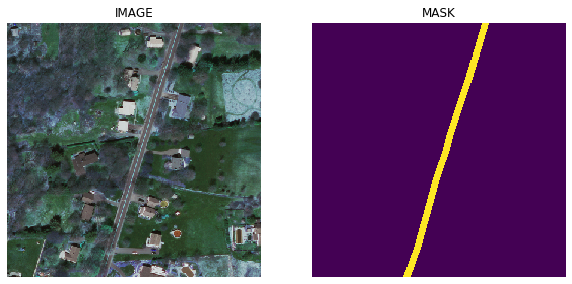

Image=250, 250 Mask=250, 250
23
Image: img-78_24.png


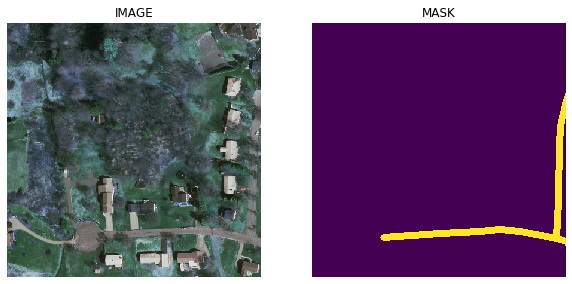

Image=250, 250 Mask=250, 250
24
Image: img-78_25.png


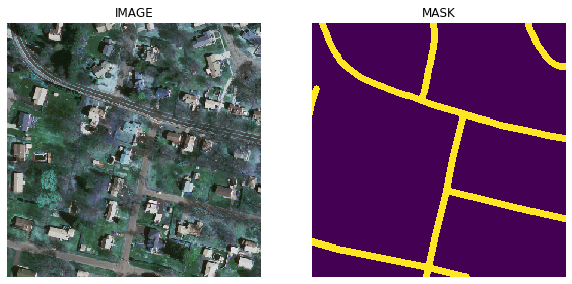

Image=250, 250 Mask=250, 250
25
Image: img-78_26.png


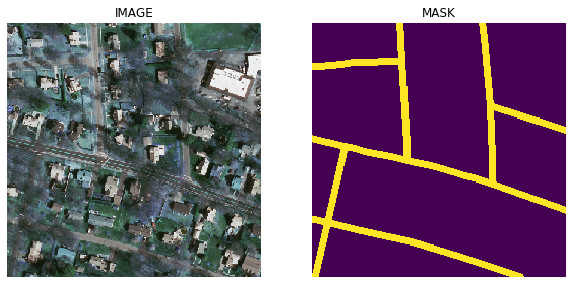

Image=250, 250 Mask=250, 250
26
Image: img-79_1.png


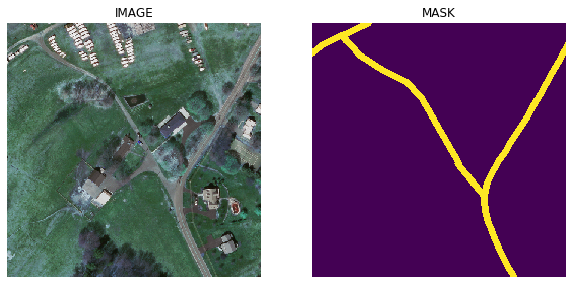

Image=250, 250 Mask=250, 250
1
Image: img-79_2.png
Image: img-79_2.png
Image: img-79_2.png


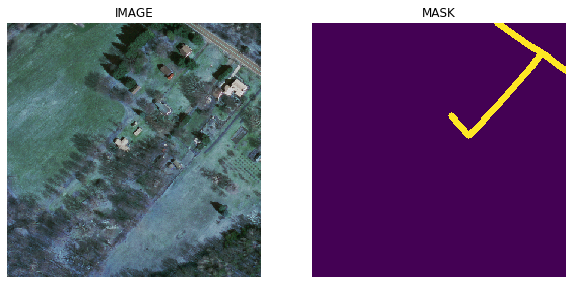

Image=250, 250 Mask=250, 250
2
Image: img-79_3.png


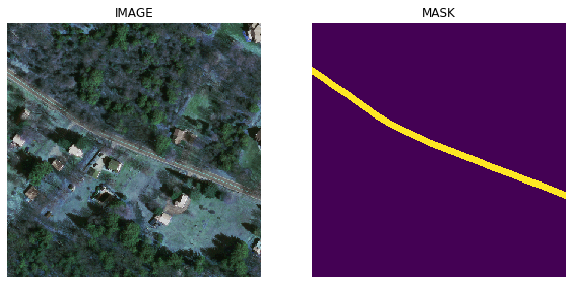

Image=250, 250 Mask=250, 250
3
Image: img-79_4.png


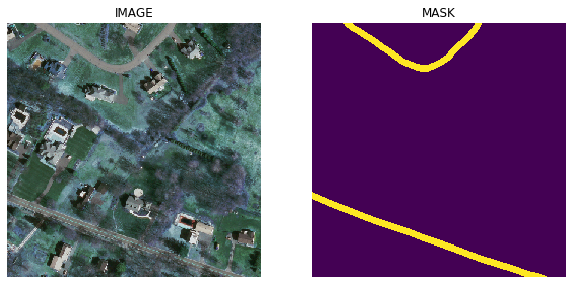

Image=250, 250 Mask=250, 250
4
Image: img-79_5.png


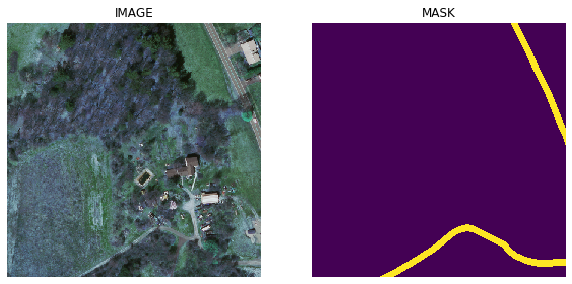

Image=250, 250 Mask=250, 250
5
Image: img-79_6.png
Image: img-79_6.png
Image: img-79_6.png
Image: img-79_6.png
Image: img-79_6.png


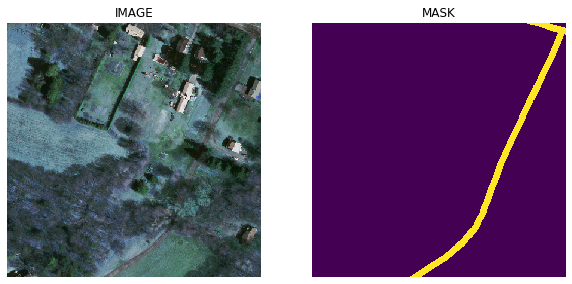

Image=250, 250 Mask=250, 250
6
Image: img-79_7.png
Image: img-79_7.png


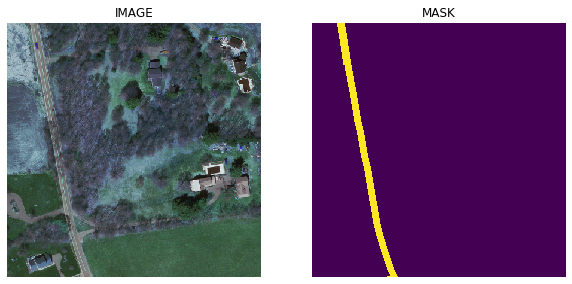

Image=250, 250 Mask=250, 250
7
Image: img-79_8.png
Image: img-79_8.png
Image: img-79_8.png


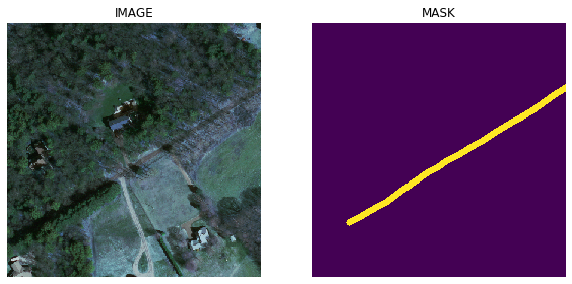

Image=250, 250 Mask=250, 250
8
Image: img-79_9.png
Image: img-79_9.png


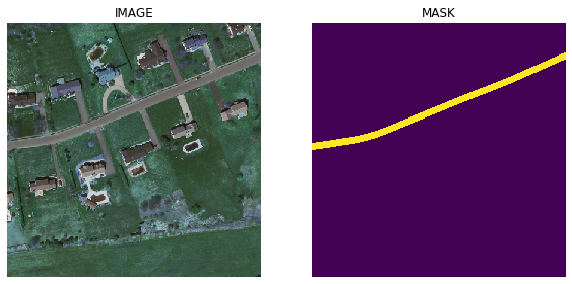

Image=250, 250 Mask=250, 250
9
Image: img-79_10.png


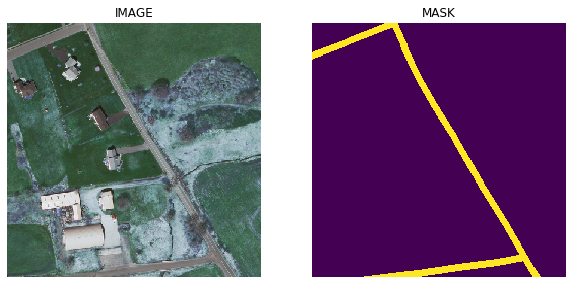

Image=250, 250 Mask=250, 250
10
Image: img-79_11.png
Image: img-79_11.png
Image: img-79_11.png
Image: img-79_11.png
Image: img-79_11.png


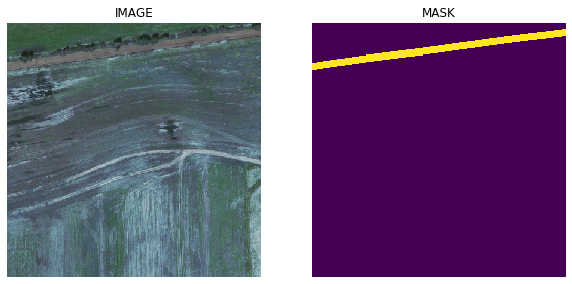

Image=250, 250 Mask=250, 250
11
Image: img-79_12.png
Image: img-79_12.png


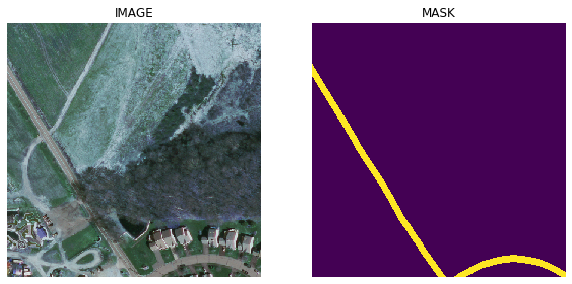

Image=250, 250 Mask=250, 250
12
Image: img-79_13.png
Image: img-79_13.png
Image: img-79_13.png
Image: img-79_13.png


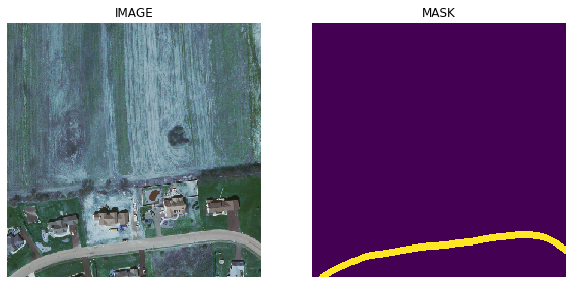

Image=250, 250 Mask=250, 250
13
Image: img-79_14.png
Image: img-79_14.png


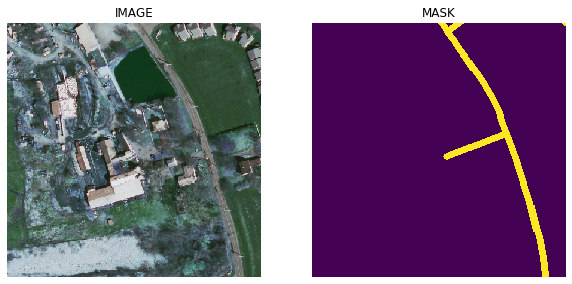

Image=250, 250 Mask=250, 250
14
Image: img-79_15.png


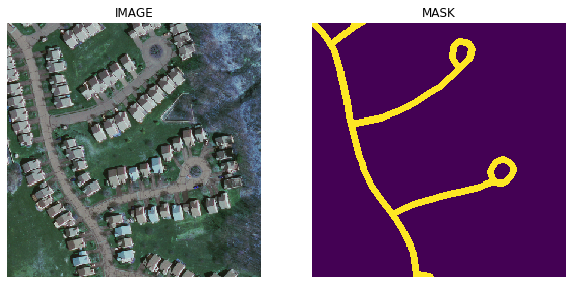

Image=250, 250 Mask=250, 250
15
Image: img-79_16.png
Image: img-79_16.png
Wall time: 58.1 s


In [26]:
%%time
image_files = ['img-71.png', 'img-72.png', 'img-73.png', 'img-74.png', 'img-77.png', 'img-78.png', 'img-79.png']
height, width = 250, 250
cutoff_ratio = 0.01
cropped_input_dir = os.path.join(data_path, 'training', 'IMAGES_1')
cropped_output_dir = os.path.join(data_path, 'training', 'MASKS_1')
if not os.path.exists(cropped_input_dir):
    os.makedirs(cropped_input_dir)
    os.makedirs(cropped_output_dir)

for image_file in image_files:
    image_path = os.path.join(new_input, image_file)
    mask_path = os.path.join(new_output, image_file)
    image = cv2.imread(image_path)
    mask = cv2.imread(mask_path, 0)

    counter = 0
    for h in range(0, image.shape[0], height):
        for w in range(0, image.shape[1], width):
            counter += 1
            new_image = np.array(image[h: h+height, w: w+width, :])
            new_mask = np.array(mask[h: h+height, w: w+width])
            
            # Output image path format
            image_name = image_file[:-4]+'_'+str(counter)+image_file[-4:]
            new_image_path = os.path.join(cropped_input_dir, image_name)
            new_mask_path = os.path.join(cropped_output_dir, image_name)
            print(f'Image: {image_name}')
            
            # Binarize out mask based on threshold
            new_mask = threshold_binarize_mask(new_mask)
            
            black_pixel_count = np.sum(new_mask==0)
            white_pixel_count = np.sum(new_mask==255)
            wht_blk_ratio = white_pixel_count/black_pixel_count
            
            # Save only when the image size=(250,250) and white/black pixel ratio > cutoff_ratio
            if new_image.shape[0]==height and new_image.shape[1]==width and wht_blk_ratio>=cutoff_ratio:
                
                show_image_and_mask(new_image, new_mask)
                print(f'Image={new_image.shape[0]}, {new_image.shape[1]} Mask={new_mask.shape[0]}, {new_mask.shape[1]}')
                print(counter)
                if not os.path.exists(new_image_path):
                    cv2.imwrite(new_image_path, new_image)
                if not os.path.exists(new_mask_path):
                    cv2.imwrite(new_mask_path, new_mask)
            else:
                counter -= 1

In [18]:
def crop_images(input_dir, out_dir, cropped_input_dir, cropped_output_dir, cutoff=True):
    
    height, width = 250, 250
    cutoff_ratio = 0.01
    start = 0  # Start pixel value
    im_counter = 0

    for image_file in os.listdir(input_dir):
        
        image_path = os.path.join(input_dir, image_file)
        mask_path = os.path.join(out_dir, image_file)
        image = cv2.imread(image_path)
        mask = cv2.imread(mask_path, 0)

        counter = 0
        for h in range(start, image.shape[0], height):
            for w in range(start, image.shape[1], width):
                counter += 1
                
                # Cropping image and mask
                new_image = np.array(image[h: h+height, w: w+width, :])
                new_mask = np.array(mask[h: h+height, w: w+width])

                # Output image path format
                image_name = image_file[:-4]+'_'+str(counter)+image_file[-4:]
                new_image_path = os.path.join(cropped_input_dir, image_name)
                new_mask_path = os.path.join(cropped_output_dir, image_name)

                # Binarize out mask based on threshold
                new_mask = threshold_binarize_mask(new_mask)

                black_pixel_count = np.sum(new_mask==0)
                white_pixel_count = np.sum(new_mask==255)
                wht_blk_ratio = white_pixel_count/black_pixel_count

                # Save only when image size=(250, 250) & white/black pixel ratio > cutoff_ratio
                if cutoff:
                    if new_image.shape[0]==height and new_image.shape[1]==width and wht_blk_ratio>cutoff_ratio:
                        # save image and mask
                        if not os.path.exists(new_image_path):
                            cv2.imwrite(new_image_path, new_image)
                            im_counter += 1
                        if not os.path.exists(new_mask_path):
                            cv2.imwrite(new_mask_path, new_mask)

                        # Print status
                        if im_counter%500==0:
                            print(f'{im_counter} images cropped')
                    else:
                        # adjust counter for invalid images
                        counter -= 1
                else:
                    if new_image.shape[0]==height and new_image.shape[1]==width:
                        if not os.path.exists(new_image_path):
                            cv2.imwrite(new_image_path, new_image)
                            im_counter += 1
                        if not os.path.exists(new_mask_path):
                            cv2.imwrite(new_mask_path, new_mask)
                    else:
                        counter -= 1
    print(f'total images = {im_counter}')
    print(f'-------Cropping finished--------')

In [28]:
cropped_input_dir = os.path.join(data_path, 'training', 'IMAGES')
cropped_output_dir = os.path.join(data_path, 'training', 'MASKS')

In [29]:
%%time

crop_images(new_input, new_output, cropped_input_dir, cropped_output_dir)

500 images cropped
1000 images cropped
1500 images cropped
2000 images cropped
2500 images cropped
3000 images cropped
3500 images cropped
4000 images cropped
4500 images cropped
5000 images cropped
5500 images cropped
6000 images cropped
6500 images cropped
7000 images cropped
7500 images cropped
8000 images cropped
8500 images cropped
9000 images cropped
9500 images cropped
10000 images cropped
10500 images cropped
11000 images cropped
11500 images cropped
12000 images cropped
12500 images cropped
13000 images cropped
13500 images cropped
14000 images cropped
14500 images cropped
15000 images cropped
15500 images cropped
16000 images cropped
16500 images cropped
17000 images cropped
17500 images cropped
18000 images cropped
18500 images cropped
19000 images cropped
19500 images cropped
20000 images cropped
20500 images cropped
total images = 20503
-------Cropping finished--------
Wall time: 15min 13s


In [30]:
# Number of files in training input and output folders

input_dir = os.path.join(data_path,'training','IMAGES')
target_dir = os.path.join(data_path,'training','MASKS')

n_input_train = len([f for f in os.listdir(input_dir) if f.endswith('png')])
print(f'NEW Input TRAIN has {n_input_train} images')
n_output_train = len([f for f in os.listdir(target_dir) if f.endswith('png')])
print(f'NEW Output TRAIN has {n_output_train} images')

NEW Input TRAIN has 20503 images
NEW Output TRAIN has 20503 images


Now, we have 20503 images and there corresponding masks

#### Random data sanity check

In [64]:
random_image_file = random.choice(os.listdir(cropped_input_dir))

random_image = cv2.imread(os.path.join(cropped_input_dir, random_image_file))
random_mask = cv2.imread(os.path.join(cropped_output_dir, random_image_file))
print(random_image_file, random_image.shape)
print(random_image_file, random_mask.shape)

img-668_34.png (250, 250, 3)
img-668_34.png (250, 250, 3)


#### Test data cropping

In [21]:
test_input_dir = os.path.join(data_path, 'testing', 'input')
test_output_dir = os.path.join(data_path, 'testing', 'output')

cropped_test_input_dir = os.path.join(data_path, 'testing', 'IMAGES')
cropped_test_output_dir = os.path.join(data_path, 'testing', 'MASKS')

In [24]:
%%time

crop_images(test_input_dir, test_output_dir, cropped_test_input_dir, cropped_test_output_dir, cutoff=False)

total images = 468
-------Cropping finished--------
Wall time: 9.48 s


Random data sanity check:

In [26]:
random_image_file = random.choice(os.listdir(cropped_test_input_dir))

random_image = cv2.imread(os.path.join(cropped_test_input_dir, random_image_file))
random_mask = cv2.imread(os.path.join(cropped_test_output_dir, random_image_file))
print(random_image_file, random_image.shape)
print(random_image_file, random_mask.shape)

img-8_2.png (250, 250, 3)
img-8_2.png (250, 250, 3)


### Data Preparation

In [73]:
# Images and Mask paths creation and quick data sanity check

input_img_paths = sorted([os.path.join(input_dir, fname) for fname in os.listdir(input_dir) if fname.endswith(".png")])

target_img_paths = sorted([os.path.join(target_dir, fname) for fname in os.listdir(target_dir) if fname.endswith(".png")])

print("Number of samples:", len(input_img_paths))
r = random.choice(range(20000))
for input_path, target_path in zip(input_img_paths[r: r+10], target_img_paths[r: r+10]):
    print(input_path, "|", target_path)

Number of samples: 20503
C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\IMAGES\img-323_5.png | C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\MASKS\img-323_5.png
C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\IMAGES\img-323_6.png | C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\MASKS\img-323_6.png
C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\IMAGES\img-323_7.png | C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\MASKS\img-323_7.png
C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\IMAGES\img-323_8.png | C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\MASKS\img-323_8.png
C:\Users\bbhagat\Documents\

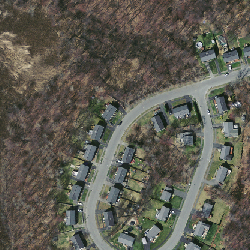

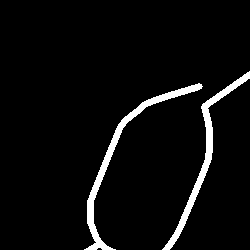

In [75]:
# Display a random input image
display(Image(filename=input_img_paths[r]))

# Display auto-contrast version of corresponding target (per-pixel categories)
img = PIL.ImageOps.autocontrast(load_img(target_img_paths[r]))
display(img)

In [81]:
random.choices([1,2,3,4,5,6,7], k=3)

[1, 5, 1]

In [83]:
(0.1*20503)

2050

In [91]:
img_path = r'C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\IMAGES_1'
msk_path = r'C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\MASKS_1'

In [3]:
def resize_img(img_dir, grayscale=False):
    count = 0
    file_list = os.listdir(img_dir)
    for im in file_list:
        if grayscale:
            img = cv2.imread(os.path.join(img_dir, im), 0)
        else:
            img = cv2.imread(os.path.join(img_dir, im))
        img1 = cv2.resize(img, (256,256))
        os.remove(os.path.join(img_dir, im))
        cv2.imwrite(os.path.join(img_dir, im), img1)
        count += 1
        if count%1000==0:
            print(f'{count} images resized')
    print(f'{count} done')

In [27]:
%%time
resize_img(cropped_test_input_dir)

468 done
Wall time: 6.82 s


In [28]:
%%time
resize_img(cropped_test_output_dir, True)

468 done
Wall time: 4.64 s


In [36]:
ims = os.listdir(cropped_test_output_dir)
random_ind = random.choices(range(len(ims)), k=10)
print(random_ind)
for r in random_ind:
    random_im = cv2.imread(os.path.join(cropped_test_output_dir, ims[r]), 0)
    print(ims[r], random_im.shape)

[82, 325, 122, 110, 428, 336, 8, 427, 302, 437]
img-12_19.png (256, 256)
img-6_10.png (256, 256)
img-13_22.png (256, 256)
img-13_11.png (256, 256)
img-8_6.png (256, 256)
img-6_20.png (256, 256)
img-10_17.png (256, 256)
img-8_5.png (256, 256)
img-5_22.png (256, 256)
img-9_14.png (256, 256)


In [1]:
masks_path = r'C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\training\MASKS'

In [5]:
%%time
resize_img(masks_path, True)

1000 images resized
2000 images resized
3000 images resized
4000 images resized
5000 images resized
6000 images resized
7000 images resized
8000 images resized
9000 images resized
10000 images resized
11000 images resized
12000 images resized
13000 images resized
14000 images resized
15000 images resized
16000 images resized
17000 images resized
18000 images resized
19000 images resized
20000 images resized
20503 done
Wall time: 5min 28s


In [17]:
# Test data sanity check
## Running this block everytime a randomly chosen image and its corr mask will appear

masks = os.listdir(masks_path)
random_ind = random.choices(range(len(masks)), k=10)
print(random_ind)
for r in random_ind:
    random_mask = cv2.imread(os.path.join(masks_path, masks[r]), 0)
    print(masks[r], random_mask.shape)

[17304, 18162, 17980, 3515, 11720, 3595, 911, 9101, 9737, 7309]
img-857_16.png (256, 256)
img-899_3.png (256, 256)
img-888_5.png (256, 256)
img-18_14.png (256, 256)
img-628_5.png (256, 256)
img-192_4.png (256, 256)
img-1063_3.png (256, 256)
img-518_2.png (256, 256)
img-552_21.png (256, 256)
img-42_21.png (256, 256)


In [108]:
def stitch_crops(in_dir, out_dir, mask=False, resize=None):
    images = os.listdir(in_dir)
    
    main_images = np.unique([im.split('_')[0] for im in images])
    im_count = 0
    for name in main_images:
        print(name+'.png')
        blank = np.zeros((6*256, 6*256)) if mask else np.zeros((6*256, 6*256, 3))
        crops = sorted([im for im in images if im.split('_')[0]==name], key=lambda x: int(x[:-4].split('_')[1]))
        for n, crop in enumerate(crops):
            img = cv2.imread(os.path.join(in_dir, crop)) if not mask else cv2.imread(os.path.join(in_dir, crop),0)
            ny, nx = n, n
            while nx-6>=0:
                nx -= 6
            w = nx*256
            h = (ny//6)*256
#             print(f'h={h}  w={w}')
            if not mask:
                blank[h: h+256, w: w+256, :] = img
            else:
                blank[h: h+256, w: w+256] = img
        print(f'blank shape {blank.shape}')
        if resize:
            blank = cv2.resize(blank, resize)
        cv2.imwrite(os.path.join(out_dir, name+'.png'), blank)
        im_count += 1
    print(f'---{im_count} images completed---')

In [109]:
img_out_dir = r'C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\testing\stitch_img'
mask_out_dir = r'C:\Users\bbhagat\Documents\Datasets\Massachusetts_Roads_Dataset\road_segmentation_ideal\testing\stitch_mask'

In [112]:
stitch_crops(cropped_test_input_dir, img_out_dir, resize=(1500, 1500, ))

img-1.png
blank shape (1536, 1536, 3)
img-10.png
blank shape (1536, 1536, 3)
img-11.png
blank shape (1536, 1536, 3)
img-12.png
blank shape (1536, 1536, 3)
img-13.png
blank shape (1536, 1536, 3)
img-2.png
blank shape (1536, 1536, 3)
img-3.png
blank shape (1536, 1536, 3)
img-4.png
blank shape (1536, 1536, 3)
img-5.png
blank shape (1536, 1536, 3)
img-6.png
blank shape (1536, 1536, 3)
img-7.png
blank shape (1536, 1536, 3)
img-8.png
blank shape (1536, 1536, 3)
img-9.png
blank shape (1536, 1536, 3)
---13 images completed---


In [113]:
stitch_crops(cropped_test_output_dir, mask_out_dir, mask=True, resize=(1500, 1500,))

img-1.png
blank shape (1536, 1536)
img-10.png
blank shape (1536, 1536)
img-11.png
blank shape (1536, 1536)
img-12.png
blank shape (1536, 1536)
img-13.png
blank shape (1536, 1536)
img-2.png
blank shape (1536, 1536)
img-3.png
blank shape (1536, 1536)
img-4.png
blank shape (1536, 1536)
img-5.png
blank shape (1536, 1536)
img-6.png
blank shape (1536, 1536)
img-7.png
blank shape (1536, 1536)
img-8.png
blank shape (1536, 1536)
img-9.png
blank shape (1536, 1536)
---13 images completed---
